# Setup

## Load packages

In [1]:
%%capture
!echo "deb http://downloads.skewed.de/apt jammy main" >> /etc/apt/sources.list
!apt-key adv --keyserver keyserver.ubuntu.com --recv-key 612DEFB798507F25
!apt-get update
!apt-get install python3-graph-tool python3-matplotlib python3-cairo

In [2]:
%%capture
!apt purge python3-cairo
!apt install libcairo2-dev pkg-config python3-dev
!pip install --force-reinstall pycairo
!pip install zstandard

In [205]:
import graph_tool.all as gt
import networkx as nx
import numpy as np
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os

## Load data

In [158]:
country_list = ['NO', 'PT', 'SK'] # Norway, Portugal, & Slovakia
year_list = range(2010, 2017, 2) # 2010 & 2012, 2014, 2016

# Create an empty dictionary to store networks
networks = {}

# Iterate over each country and year to import networks
for country in country_list:

  for year in year_list:

    network_title = f'{country}_{year}'
    networks[network_title] = gt.collection.ns[f'eu_procurements_alt/{network_title}']

In [92]:
# Inspect networks
networks

{'NO_2010': <Graph object, undirected, with 2265 vertices and 2673 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x78cf3c90d900>,
 'NO_2012': <Graph object, undirected, with 2318 vertices and 2782 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x78cf3d0aca90>,
 'NO_2014': <Graph object, undirected, with 2256 vertices and 2678 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x78cf3d0ac2b0>,
 'NO_2016': <Graph object, undirected, with 2851 vertices and 3627 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x78cf8d6fdcc0>,
 'PT_2010': <Graph object, undirected, with 1382 vertices and 1378 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x78cf3de91a80>,
 'PT_2012': <Graph object, undirected, with 1175 vertices and 1123 edges, 2 internal vertex pro

## Create projections from bipartite network

In [159]:
# Initialize an empty dictionary to store networkx graphs
networks_nx = {}

for network, g_tool_graph in networks.items():

    # Initialize a new networkx graph for the current dataset
    g_nx = nx.Graph()

    # Add vertices and corresponding properties to the networkx graph
    for v in g_tool_graph.vertices():

        # Here, 'v_prop' is a dictionary of the vertex properties
        v_prop = {prop: g_tool_graph.vp[prop][v] for prop in g_tool_graph.vertex_properties.keys()}
        g_nx.add_node(v, **v_prop)

    # Add edges and corresponding properties to the networkx graph
    for e in g_tool_graph.edges():

        # Here, 'e_prop' is a dictionary of the edge properties
        e_prop = {prop: g_tool_graph.ep[prop][e] for prop in g_tool_graph.edge_properties.keys()}
        g_nx.add_edge(e.source(), e.target(), **e_prop)

    # Append the networkx graph to our dictionary
    networks_nx[network] = g_nx

In [186]:
# Initialize empty dictionary to store projections
networks_proj = {}

# Function to create and return both issuer and winner projections from a bipartite graph
def create_projections(g):

    issuers_set = {n for n, d in g.nodes(data=True) if d['label'].endswith('_i')}
    winners_set = {n for n, d in g.nodes(data=True) if d['label'].endswith('_w')}

    # Create the bipartite projections
    issuer_proj = nx.algorithms.bipartite.projected_graph(g, issuers_set)
    winner_proj = nx.algorithms.bipartite.projected_graph(g, winners_set)

    return issuer_proj, winner_proj

# Function to convert a networkx graph to a graph-tool graph
def convert_networkx_to_graphtool(g_nx, name_description):

    g_gt = gt.Graph(directed=False)
    pos_property = g_gt.new_vertex_property("vector<double>")
    label_property = g_gt.new_vertex_property("string")
    vertex_map = {node: g_gt.add_vertex() for node in g_nx}

    for node, data in g_nx.nodes(data=True):

        v = vertex_map[node]
        pos_property[v] = data.get('_pos', [0.0, 0.0])
        label_property[v] = data['label']

    for u, v in g_nx.edges():

        g_gt.add_edge(vertex_map[u], vertex_map[v])

    # Set the graph name and description properties
    g_gt.graph_properties["name"] = g_gt.new_graph_property("string", name_description[0])
    g_gt.graph_properties["description"] = g_gt.new_graph_property("string", name_description[1])

    return g_gt, pos_property, label_property

# Loop over each network in datasets_nx
for dataset_key, g_nx in networks_nx.items():

    # Split the key to get country and year
    country, year = dataset_key.split('_')

    # Create the projections
    issuer_proj, winner_proj = create_projections(g_nx)

    # Convert projections to graph-tool format
    name_description = (f"eu_procurements_alt ({country}_{year}_issuer)",
                        "Issuer projection of the bipartite graph")

    networks_proj[f"{country}_{year}_issuer"], _, _ = convert_networkx_to_graphtool(issuer_proj, name_description)

    name_description = (f"eu_procurements_alt ({country}_{year}_winner)",
                        "Winner projection of the bipartite graph")

    networks_proj[f"{country}_{year}_winner"], _, _ = convert_networkx_to_graphtool(winner_proj, name_description)

# Separate projections by winners and issuers
winners_proj = {network_title: g for network_title, g in networks_proj.items() if network_title.endswith('_winner')}
issuers_proj = {network_title: g for network_title, g in networks_proj.items() if network_title.endswith('_issuer')}


# Overall network properties


In [190]:
networks['NO_2010']

<Graph object, undirected, with 2265 vertices and 2673 edges, 2 internal vertex properties, 2 internal edge properties, 5 internal graph properties, at 0x78cf3c90d900>

In [191]:
networks['NO_2010'].list_properties()

name             (graph)   (type: string, val: eu_procurements_alt (NO_2010))
description      (graph)   (type: string, val: These 234 networks represent the
                                               annual national public
                                               procurement markets of 26
                                               European countries from
                                               2008-2016, inclusive. Data is
                                               sourced from Tenders Electronic
                                               Daily (TED), the official
                                               procurement portal of the
                                               European Union.  Nodes with the
                                               suffix "_i" are issuers
                                               (sometimes referred to as
                                               buyers) of public contracts, for
                       

## Degree distribution

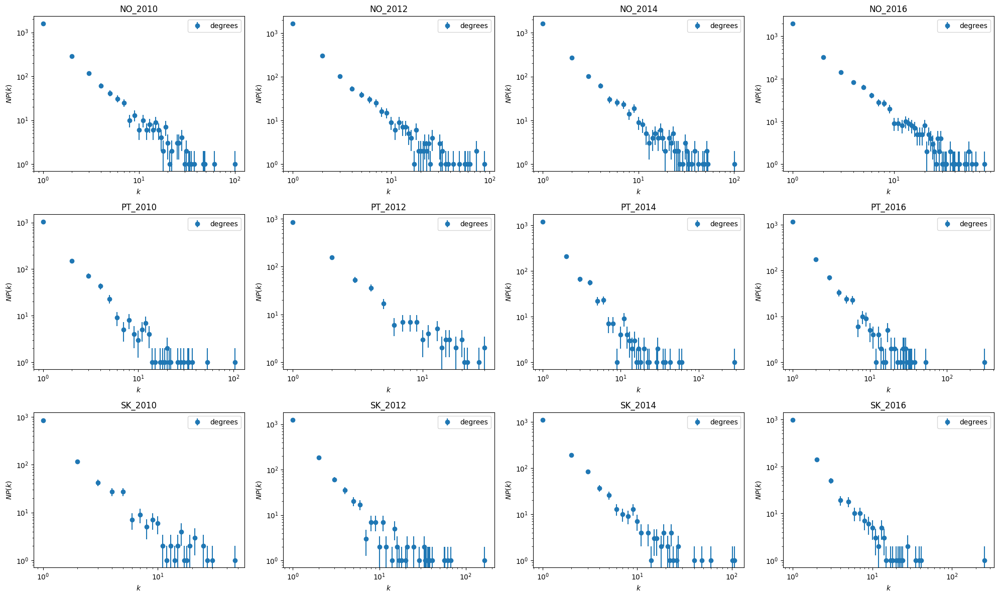

In [193]:
# TODO: Add power law distribution ---------------------------------------------

# Create a figure with subplots
fig, axes = plt.subplots(3, 4, figsize=((20, 12)))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (network_title, g) in enumerate(networks.items()):

    ax = axes[i]
    hist = gt.vertex_hist(g, "total")
    y = hist[0]
    err = np.sqrt(hist[0])
    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")
    ax.set_yscale("log")
    ax.set_xscale("log")
    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(network_title)
    ax.legend()

plt.tight_layout()
plt.show()

## Layouts

In [202]:
# Function to draw a graph-tool graph using the edge properties 'count' and 'pctSingleBid'. Here, 'count' is the number of contracts
# between two nodes and 'pctSingleBid' is the percentage of contracts between two nodes that were single-bid contracts. 'count' is used
# as weight for the edge pen width and 'pctSingleBid' is used to color the edges where the edges become more red as the percentage of
# single-bid contracts increases, i.e. goes from 0 to 1. The vertex color is determined by the vertex type, i.e. 'issuer' or 'winner'.
# The vertex type is determined by the vertex label, which ends with '_i' for issuers and '_w' for winners. The vertex outline is black
# for all vertices. The vertex pen width is set to 1.2. The function returns a dictionary with the drawing parameters.

def draw_weighted_colored_graph(u, edge_color_property_name='edge_color'):
    """
    Prepares edge color, pen width, and vertex color based on 'count', 'pctSingleBid',
    and vertex type ('issuer' or 'winner').
    Designed to be used within gt.graph_draw.
    :param u: The graph for which the drawing parameters are being prepared.
    :param edge_color_property_name: The name to be assigned to the new edge color property.
    :return: A dictionary with the edge_color, edge_pen_width, vertex_fill_color, and vertex_outline properties.
    """
    # Retrieve the 'count' and 'pctSingleBid' edge properties
    edge_count = u.ep["count"]
    edge_pctSingleBid = u.ep["pctSingleBid"]

    # Create a new edge property for the matplotlib color mapping
    edge_color = u.new_edge_property('vector<double>')
    u.ep[edge_color_property_name] = edge_color

    # Create color maps and normalization instance for edges
    cmap = plt.get_cmap('coolwarm')
    norm = matplotlib.colors.Normalize(vmin=0, vmax=1)  # 'pctSingleBid' is between 0 and 1

    # Assign colors to edges based on 'pctSingleBid' values
    for e in u.edges():
        normalized_value = norm(edge_pctSingleBid[e])
        edge_color[e] = cmap(normalized_value)

    # Prepare vertex color properties
    vertex_fill_color = u.new_vertex_property('vector<double>')
    vertex_outline = u.new_vertex_property('vector<double>')  # For the boundary

    # Check the vertex 'label' property and assign colors accordingly
    for v in u.vertices():
        label = u.vp.label[v]
        if label.endswith("_i"):  # Check if the vertex label ends with '_i'
            vertex_fill_color[v] = [0.5, 0.5, 0.5, 1]  # White for issuers
        elif label.endswith("_w"):  # Check if the vertex label ends with '_w'
            vertex_fill_color[v] = [1, 1, 1, 1]  # Gray for winners
        vertex_outline[v] = [0, 0, 0, 1]  # Black outline for all vertices

    # Prepare the dictionary with drawing parameters
    drawing_parameters = {
        'edge_color': edge_color,
        'edge_pen_width': gt.prop_to_size(edge_count, mi=0.5, ma=25, power=1),
        'vertex_fill_color': vertex_fill_color,
        'vertex_color': vertex_outline,  # This is for the boundary
        'vertex_pen_width': 1.2  # Adjust the pen width as needed
    }

    return drawing_parameters

### Default layout

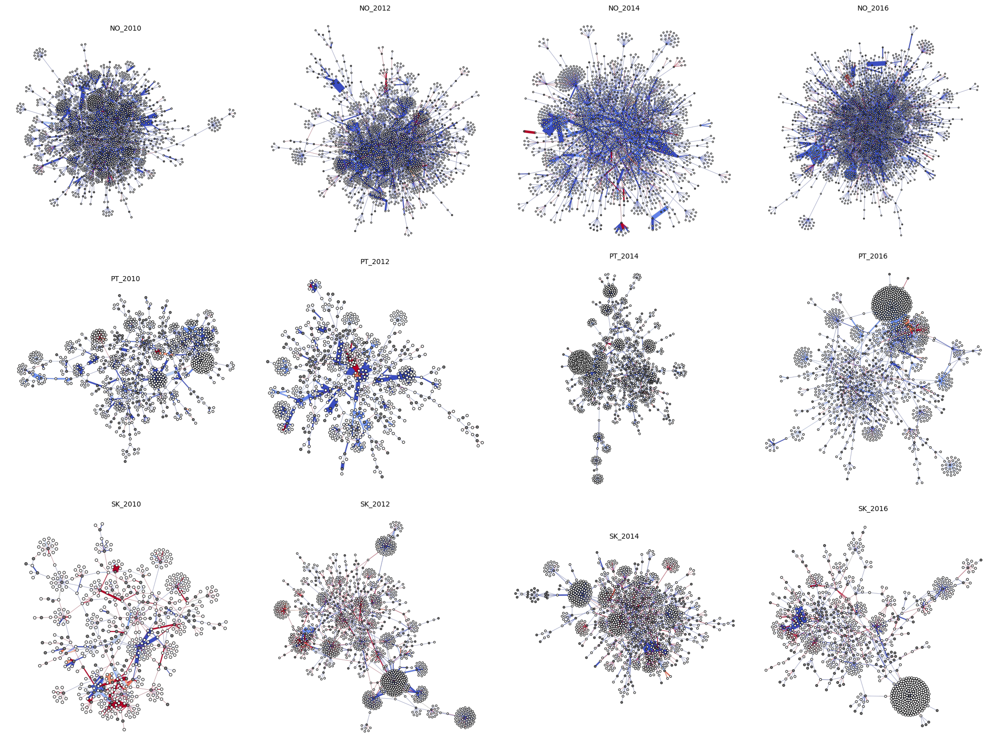

In [209]:
# Ensure the output directory exists for the stored positions
output_dir_vp = "default_layout"
os.makedirs(output_dir_vp, exist_ok=True)

# Loop through each dataset and save the graph using the stored positions as an image
for network_title, g in networks.items():
    u = gt.extract_largest_component(g, prune=True)
    output_path = os.path.join(output_dir_vp, f"{network_title}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos=u.vp["_pos"], output=output_path,**drawing_parameters)

# Get the list of all saved images for the stored positions
image_files_vp = sorted([os.path.join(output_dir_vp, f) for f in os.listdir(output_dir_vp) if f.endswith('.png')])

# Create the figure with subplots for the stored positions
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for the stored positions and add it to the subplot
for i, image_file in enumerate(image_files_vp):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes

    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

### Spring layout

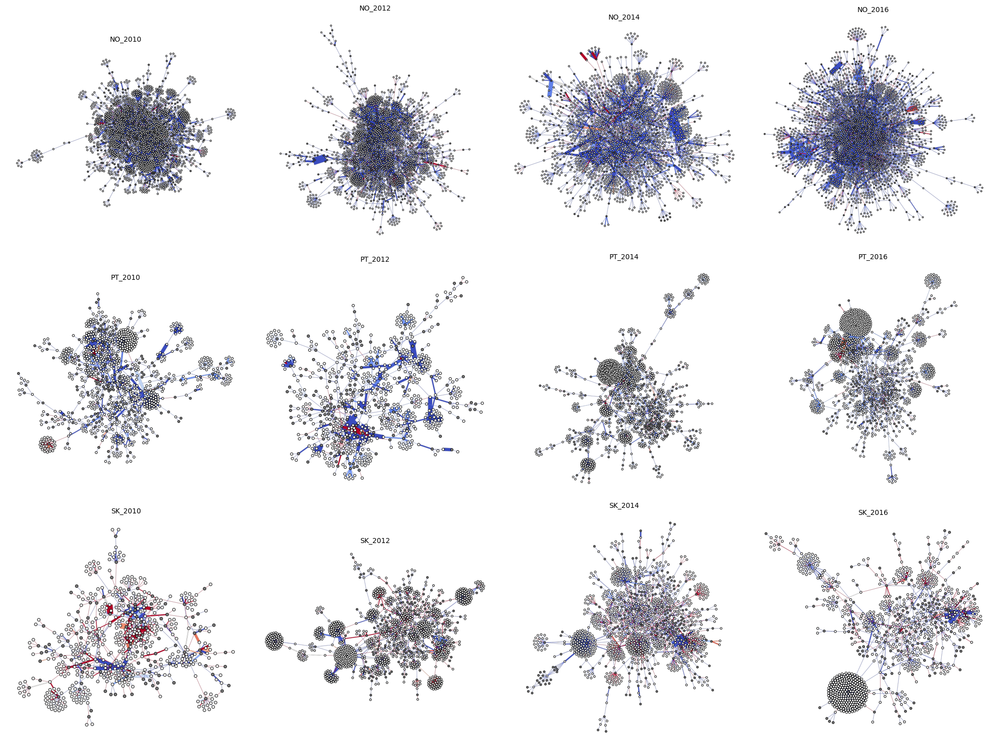

In [206]:
# Ensure the output directory exists
output_dir = "sfdp_layout"
os.makedirs(output_dir, exist_ok=True)

# Loop through each dataset and save the graph as an image
for network_title, g in networks.items():
    u = gt.extract_largest_component(g, prune=True)
    pos = gt.sfdp_layout(u)
    output_path = os.path.join(output_dir, f"{network_title}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos, output=output_path, **drawing_parameters)


# Get the list of all saved images
image_files = sorted([os.path.join(output_dir, f) for f in os.listdir(output_dir) if f.endswith('.png')])

# Create the figure with subplots
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

# Flatten the axes array for easy iteration, in case of a 2D axes array
axes = axes.flatten()

# Loop through each image file and add it to the subplot
for i, image_file in enumerate(image_files):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Turn off the axis

    # Set the title for the subplot using the filename
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust layout and display
plt.tight_layout()
plt.show()

### Fruchterman-Reingold layout

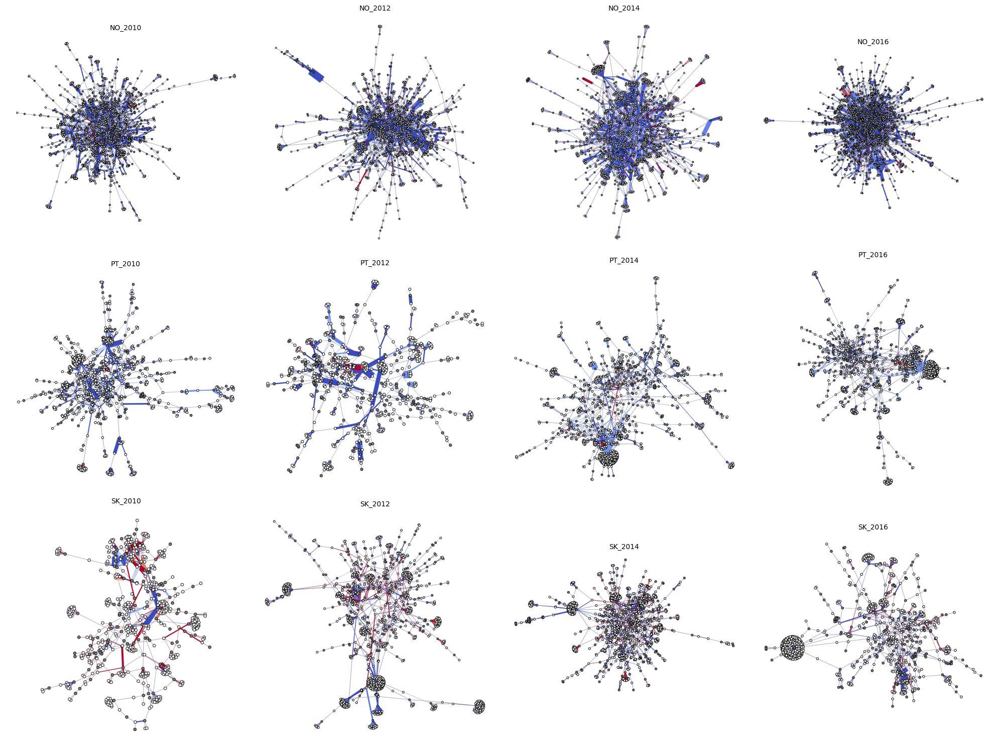

In [210]:
# Ensure the output directory exists for Fruchterman-Reingold layouts
output_dir_fr = "fr_layout"
os.makedirs(output_dir_fr, exist_ok=True)

# Loop through each dataset and save the graph with Fruchterman-Reingold layout as an image
for network_title, g in networks.items():
    u = gt.extract_largest_component(g, prune=True)
    pos_fr = gt.fruchterman_reingold_layout(u, n_iter=100)  # Set the number of iterations if needed
    output_path = os.path.join(output_dir_fr, f"{network_title}.png")
    drawing_parameters = draw_weighted_colored_graph(u)
    gt.graph_draw(u, pos_fr, output=output_path, **drawing_parameters)

# Get the list of all saved images for Fruchterman-Reingold layouts
image_files_fr = sorted([os.path.join(output_dir_fr, f) for f in os.listdir(output_dir_fr) if f.endswith('.png')])

# Create the figure with subplots for Fruchterman-Reingold layouts
fig, axes = plt.subplots(3, 4, figsize=(20, 15))

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each image file for Fruchterman-Reingold layouts and add it to the subplot
for i, image_file in enumerate(image_files_fr):
    img = mpimg.imread(image_file)
    axes[i].imshow(img)
    axes[i].axis('off')  # Hide the axes

    # Set the title for the subplot
    axes[i].set_title(image_file.split('/')[-1].replace('.png', ''), fontsize=10)

# Adjust the layout and show the visualization
plt.tight_layout()
plt.show()

# Projected network properties

In [213]:
# Use Norway, 2010 as a test case ----------------------------------------------
g_i = issuers_proj['NO_2010_issuer']
g_w = winners_proj['NO_2010_winner']

In [217]:
networks_proj['NO_2010_issuer'], networks_proj['NO_2010_winner']

(<Graph object, undirected, with 485 vertices and 2306 edges, 2 internal graph properties, at 0x78cf3b66a140>,
 <Graph object, undirected, with 1780 vertices and 24242 edges, 2 internal graph properties, at 0x78cf3c114940>)

In [216]:
networks_proj['NO_2010_issuer']

<Graph object, undirected, with 485 vertices and 2306 edges, 2 internal graph properties, at 0x78cf3b66a140>

## Degree distribution

In [ ]:
# Power Law Distribution -------------------------------------------------------

# # Parameters for the power-law distribution
# alpha = 5  # Power-law exponent
# xmin = 1  # Minimum value

# data = g_i.get_total_degrees(g_i.get_vertices())

# # Create a histogram of the data
# hist, bin_edges = np.histogram(data, density=True)

# # Calculate the midpoints of the bins for x values
# x = (bin_edges[1:] + bin_edges[:-1]) / 2

# # Plot the data with logged x and y axes
# plt.figure(figsize=(8, 6))
# plt.plot(x, hist, 'o', markersize=4, label='Data')

# # Plot the power-law distribution
# x_fit = np.logspace(np.log10(min(data)), np.log10(max(data)), 100)
# y_fit = (alpha - 1) * xmin ** (alpha - 1) * x_fit ** (-alpha)
# plt.plot(x_fit, y_fit, label=f'Power Law (alpha={alpha})', color='red')

# plt.xscale('log')
# plt.yscale('log')
# plt.xlabel('Log X-axis')
# plt.ylabel('Log Y-axis')
# plt.title('Power Law Distribution')
# plt.legend()
# plt.grid(True)

# plt.show()

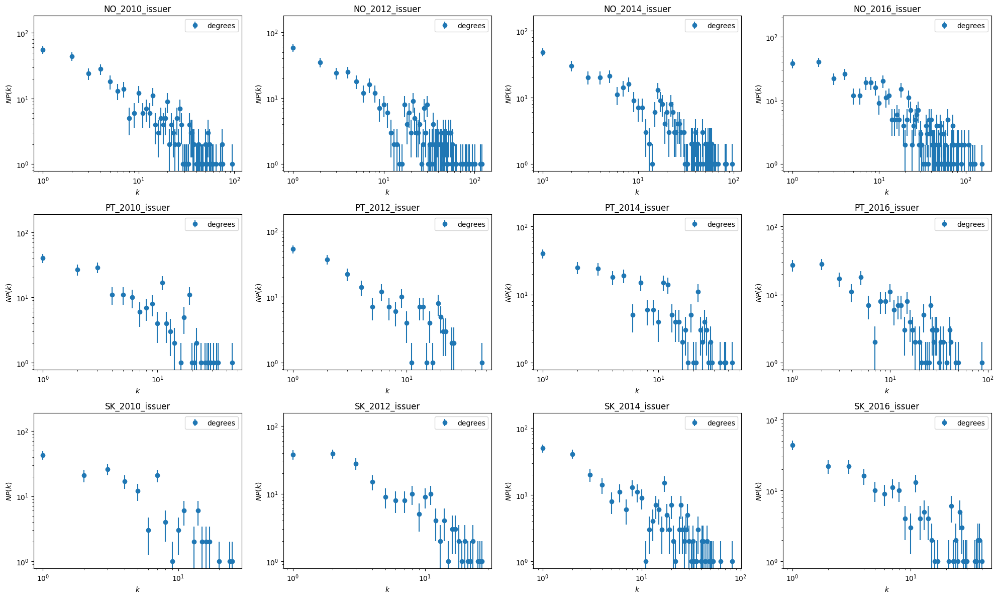

In [149]:
# TODO: Add power law distribution ---------------------------------------------

# Create a figure with subplots
fig, axes = plt.subplots(3, 4, figsize=((20, 12)))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (network_title, g) in enumerate(issuers_proj.items()):

    ax = axes[i]
    hist = gt.vertex_hist(g, "total")
    y = hist[0]
    err = np.sqrt(hist[0])
    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")
    ax.set_yscale("log")
    ax.set_xscale("log")
    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(network_title)
    ax.legend()

plt.tight_layout()
plt.show()

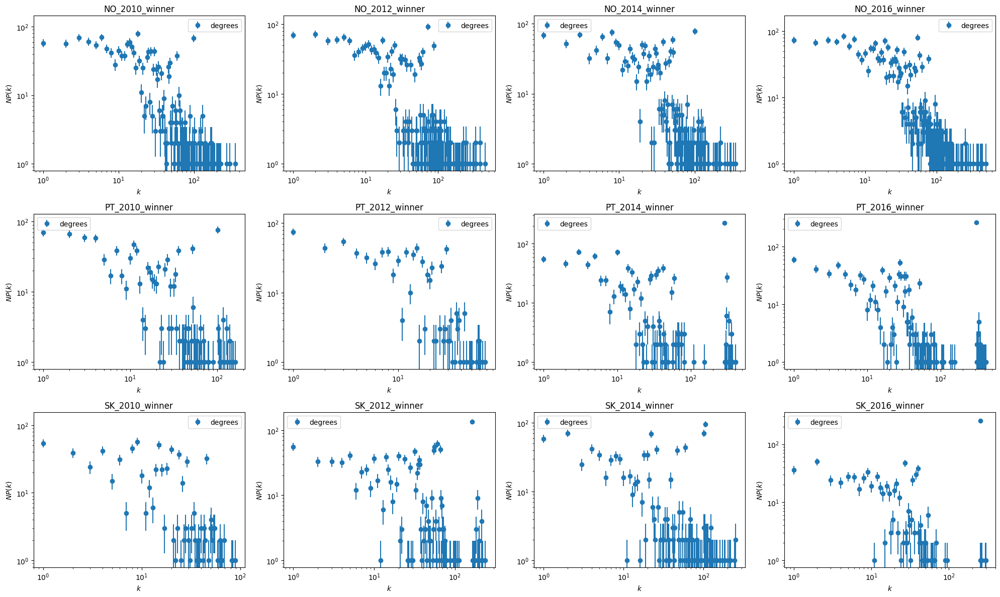

In [150]:
# TODO: Add power law distribution ---------------------------------------------

# Create a figure with subplots
fig, axes = plt.subplots(3, 4, figsize=((20, 12)))
plt.subplots_adjust(wspace=0.4, hspace=0.6)

# Flatten the axes array for easy iteration
axes = axes.flatten()

# Loop through each dataset and create plots
for i, (network_title, g) in enumerate(winners_proj.items()):

    ax = axes[i]
    hist = gt.vertex_hist(g, "total")
    y = hist[0]
    err = np.sqrt(hist[0])
    ax.errorbar(hist[1][:-1], y, fmt="o", yerr=err, label="degrees")
    ax.set_yscale("log")
    ax.set_xscale("log")
    ax.set_xlabel("$k$")
    ax.set_ylabel("$NP(k)$")
    ax.set_title(network_title)
    ax.legend()

plt.tight_layout()
plt.show()

## Diameters

The pseudo-diameter is an approximate graph diameter. It is obtained by starting from a vertex source, and finds a vertex target that is farthest away from source. This process is repeated by treating target as the new starting vertex, and ends when the graph distance no longer increases. A vertex from the last level set that has the smallest degree is chosen as the final starting vertex u, and a traversal is done to see if the graph distance can be increased. This graph distance is taken to be the pseudo-diameter.

The paths are computed with a breadth-first search (BFS) or Dijkstra’s algorithm [dijkstra], if weights are given.

https://graph-tool.skewed.de/static/doc/autosummary/graph_tool.topology.pseudo_diameter.html#graph_tool.topology.pseudo_diameter

In [234]:
for network_title, g in issuers_proj.items():
  g = networks_proj[network_title]
  u = gt.extract_largest_component(g, prune=True)
  dist, ends = gt.pseudo_diameter(u)
  print(network_title, dist)

NO_2010_issuer 7.0
NO_2012_issuer 7.0
NO_2014_issuer 6.0
NO_2016_issuer 6.0
PT_2010_issuer 9.0
PT_2012_issuer 9.0
PT_2014_issuer 9.0
PT_2016_issuer 8.0
SK_2010_issuer 6.0
SK_2012_issuer 8.0
SK_2014_issuer 7.0
SK_2016_issuer 8.0


In [237]:
for network_title, g in winners_proj.items():
  g = networks_proj[network_title]
  u = gt.extract_largest_component(g, prune=True)
  dist, ends = gt.pseudo_diameter(u)
  print(network_title, dist)

NO_2010_winner 8.0
NO_2012_winner 8.0
NO_2014_winner 6.0
NO_2016_winner 7.0
PT_2010_winner 9.0
PT_2012_winner 10.0
PT_2014_winner 10.0
PT_2016_winner 8.0
SK_2010_winner 7.0
SK_2012_winner 8.0
SK_2014_winner 6.0
SK_2016_winner 8.0


# Layouts

## Spring layout

In [63]:
# Use the 'sfdp_layout' function to calculate the layout positions of vertices in the graph 'u'.
# 'sfdp_layout' is a force-directed layout algorithm that helps determine the spatial arrangement
# of nodes (vertices) in the graph, based on their relationships and connections.
pos_i, pos_w = gt.sfdp_layout(u_i), gt.sfdp_layout(u_w)

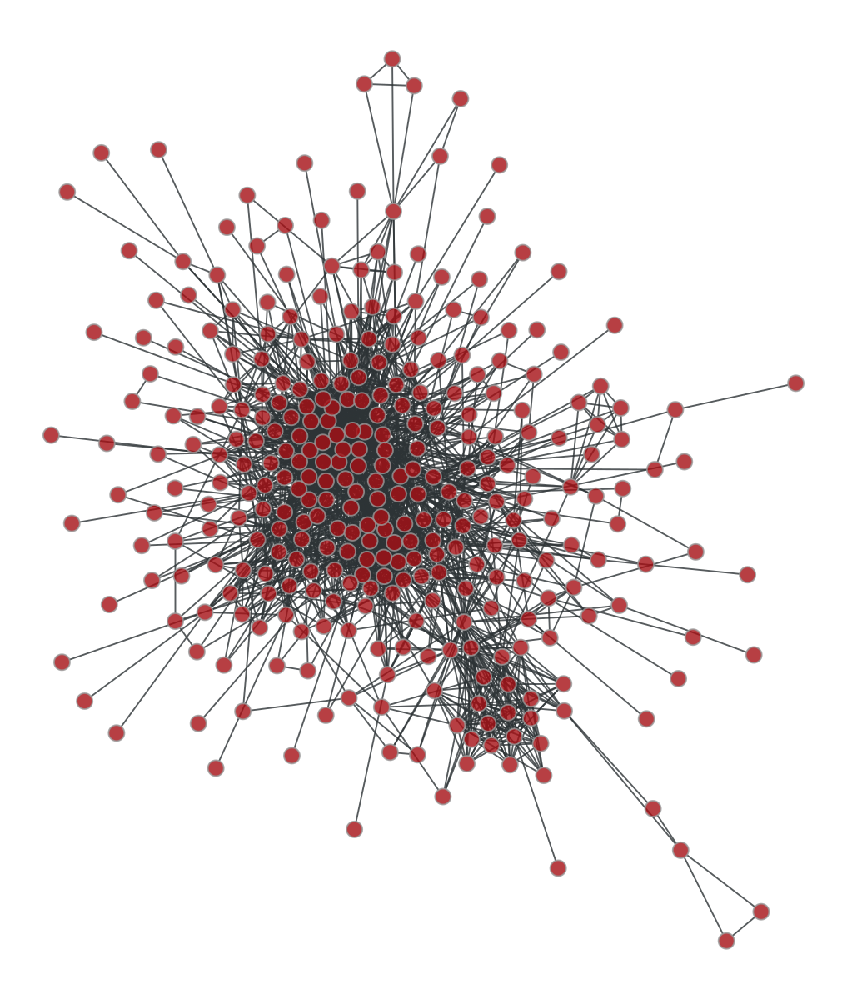

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf3e3c7a90>

In [64]:
# Use 'graph_draw' to render the graph 'u' using the calculated layout 'pos'.
# This function visualizes the graph by rendering its nodes and edges according to the specified layout.
gt.graph_draw(u_i, pos_i)

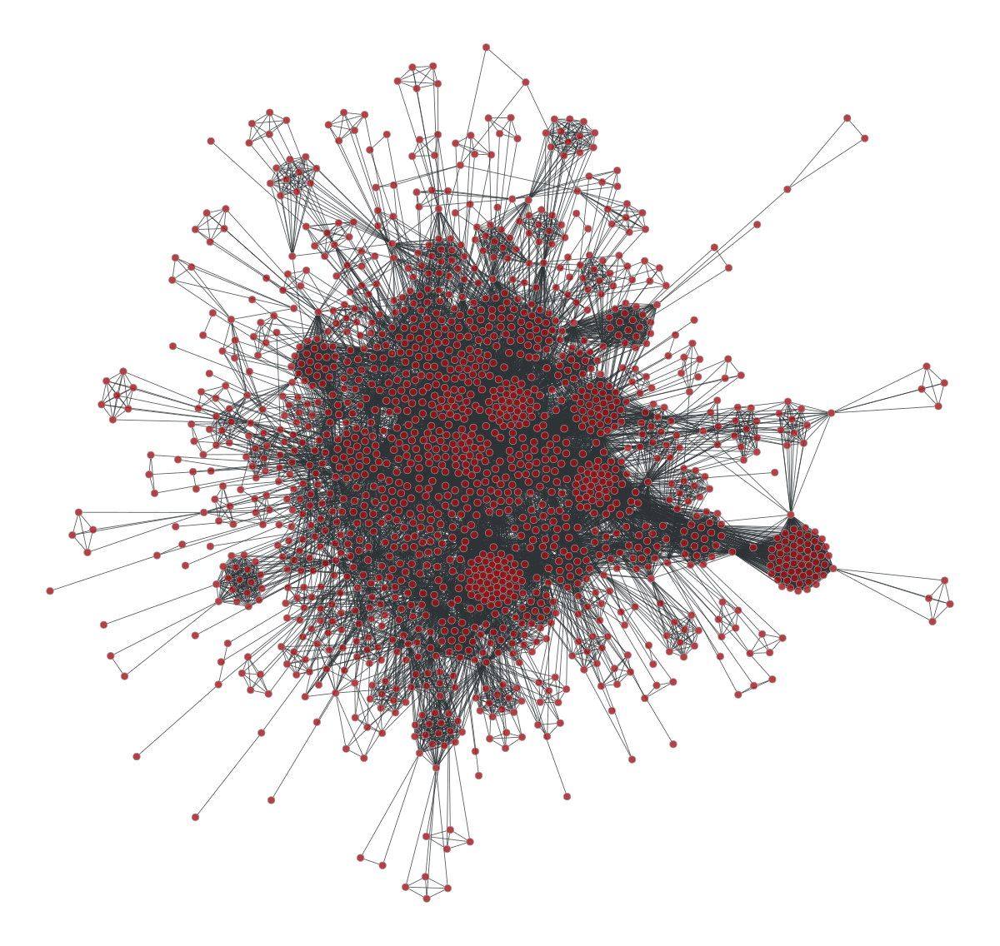

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf3e3c7eb0>

In [65]:
# Use 'graph_draw' to render the graph 'u' using the calculated layout 'pos'.
# This function visualizes the graph by rendering its nodes and edges according to the specified layout.
gt.graph_draw(u_w, pos_w)

## Fruchterman-Reingold layout

In [66]:
# Calculate the layout positions of the graph 'u' using the Fruchterman-Reingold force-directed layout algorithm.
# This layout algorithm determines the spatial arrangement of nodes in the graph based on attractive and repulsive forces.
# 'n_iter' is set to 100 to control the number of iterations for layout convergence.
pos_fr_i, pos_fr_w = gt.fruchterman_reingold_layout(u_i, n_iter=100), gt.fruchterman_reingold_layout(u_w, n_iter=100)

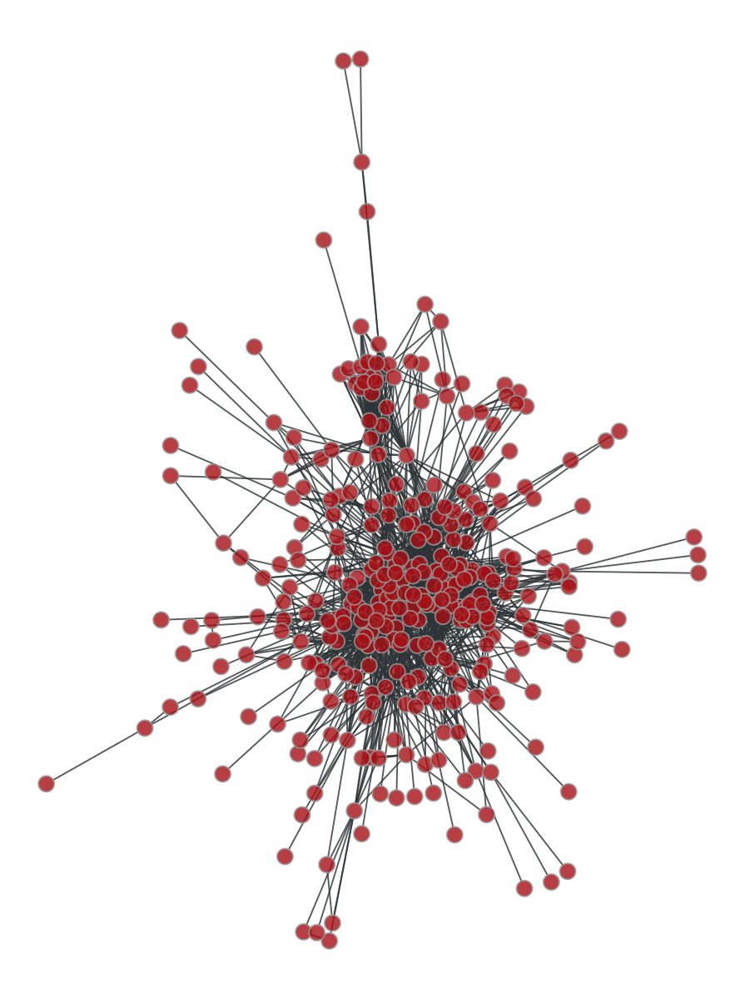

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf3e3cbd00>

In [67]:
gt.graph_draw(u_i, pos_fr_i)

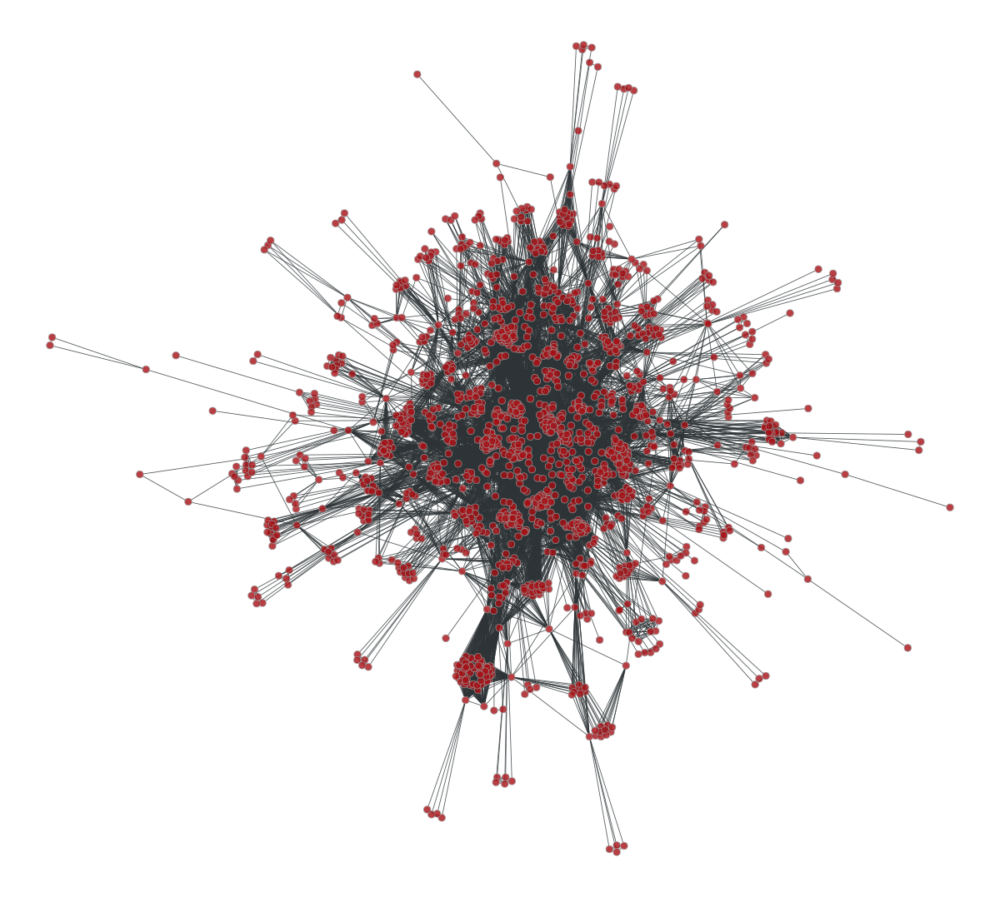

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf3e3cb8b0>

In [68]:
gt.graph_draw(u_w, pos_fr_w)

## Radial tree

In [69]:
# Calculate the radial tree layout for the graph 'u' starting from vertex 0.
# A radial tree layout is a layout algorithm that arranges the vertices in a tree-like structure
# with a central vertex (in this case, vertex 0) at the center and its connected vertices branching outward.
pos_tree_i, pos_tree_w = gt.radial_tree_layout(u_i, 0), gt.radial_tree_layout(u_w, 0)

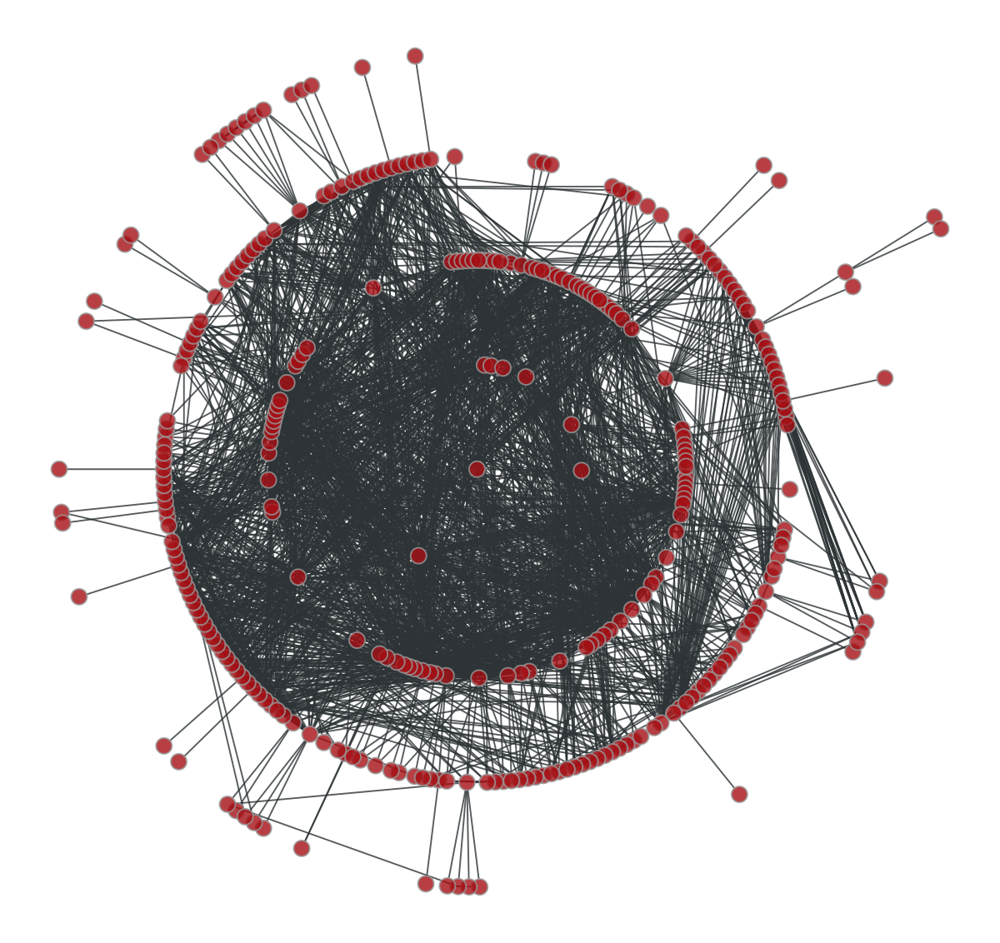

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf3e3cada0>

In [70]:
gt.graph_draw(u_i, pos_tree_i)

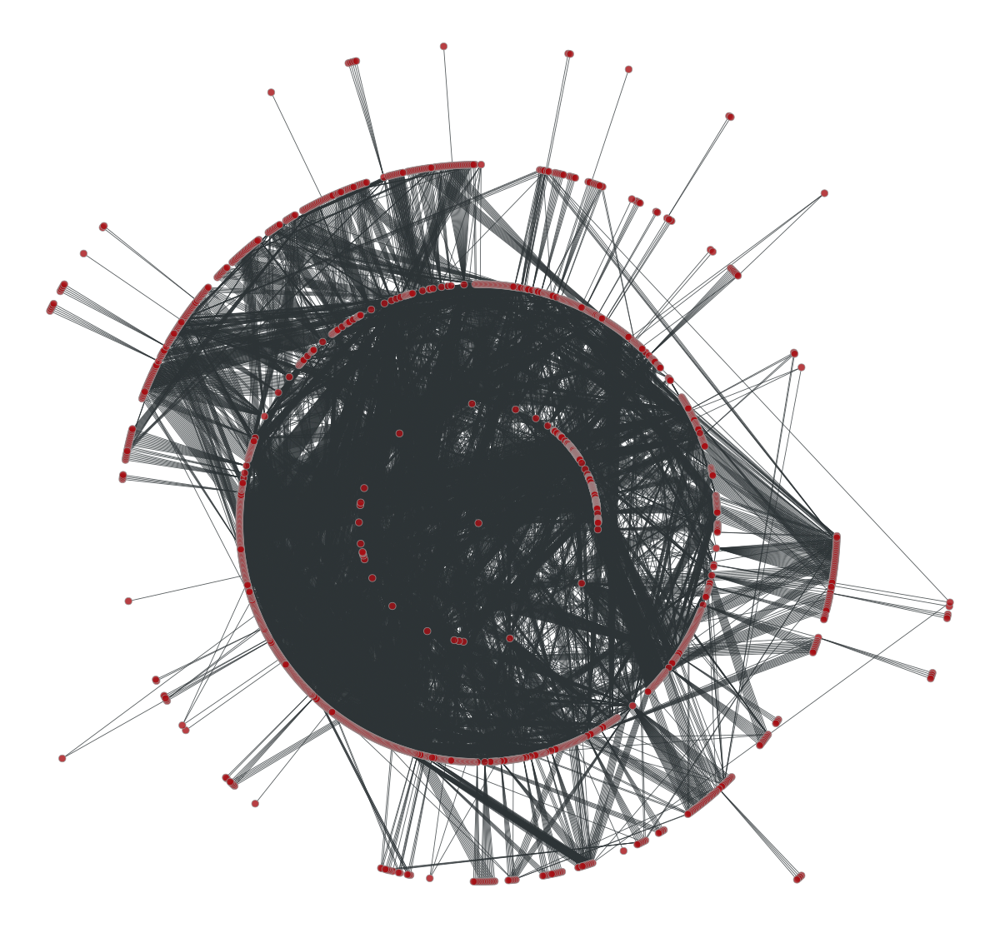

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf3e3c9720>

In [71]:
gt.graph_draw(u_w, pos_tree_w)

In [72]:
# Calculate the maximum degree (number of edges) in the graph 'u'
maximum_i = max(u_i.get_total_degrees(u_i.get_vertices()))

# Print the indices of vertices with the maximum degree.
# This will identify the vertices with the highest number of edges.
print(np.where(u_i.get_total_degrees(u_i.get_vertices()) == maximum_i))

# Print the degrees of all vertices in the graph.
print(u_i.get_total_degrees(u_i.get_vertices()))

(array([50]),)
[ 7  6 11  8 16  1  3  6  4  1  6  2  6  4 36  2  7  7  6  2  8 35  2 10
  3 18 11  7  5  8 17  5  9 19  5  3 28 23 38 12 15 12 57 14 17  9 39  1
 10 19 77 50  2  5  5  1  1  1 38  5 24  2  5  2 13  3  3  2 49  2  2  1
  1 18  1 29 64  5 53  3 33  3  3  6 23 13  1 22  5 51 26 13  7  1 10  4
 16 25  5  6  4  1  2  7 23  6  7  1 14 18  4  5 12  2  1 11 11 51  9 12
 19 13  2  2 34  3  1  3  1  2  2  6 16  1 22  3  9  4 12 36 12  1  4 27
 35  2  1 24  1 36  1 29  3  2  2 18  4 10  1 37 10  2 36  1  8 18  9  4
  1  4 67 11  1 17 20  8  8 33 10 17  2  2 33 56  5  4 28  3  1 71  1 27
  3 25 16 16 19 35 26  1 11 10  2  5 10 35 34  2 15  7 19  1  2 52  1 12
  8  3  9  8 20 19 23 21 33 25  1 33  2 36 38 11  7 15  6  1  1 31  2  5
 27  9  2 30  4 22 26  7 31 40 21  6 26 16 12 23  4 16 35  1 10  2  9  3
  9  2 10 11  3  7 11 20 66  2  9 18 23  1 15  1  8 22  2 29 16  3  9  9
  9 12 23 19 29 16  8 25 25  2 27  1  7  2  7  3 39  4 12  1 10  7  1  9
 10 15 21 12 12  1 14  7 16  2 33]


In [73]:
# Calculate the maximum degree (number of edges) in the graph 'u'
maximum_w = max(u_w.get_total_degrees(u_w.get_vertices()))

# Print the indices of vertices with the maximum degree.
# This will identify the vertices with the highest number of edges.
print(np.where(u_w.get_total_degrees(u_w.get_vertices()) == maximum_w))

# Print the degrees of all vertices in the graph.
print(u_w.get_total_degrees(u_w.get_vertices()))

(array([175]),)
[134  14  18 ...  38  38  38]


In [74]:
# TODO: Adapt by placing node with most degrees at the center of the radial tree plot --------------------

# Calculate the radial tree layout for the graph 'u' starting from vertex 1.
# A radial tree layout is a layout algorithm that arranges the vertices in a tree-like structure
# with a central vertex (in this case, vertex 1) at the center and its connected vertices branching outward.
pos_tree_i = gt.radial_tree_layout(u_i, 1)

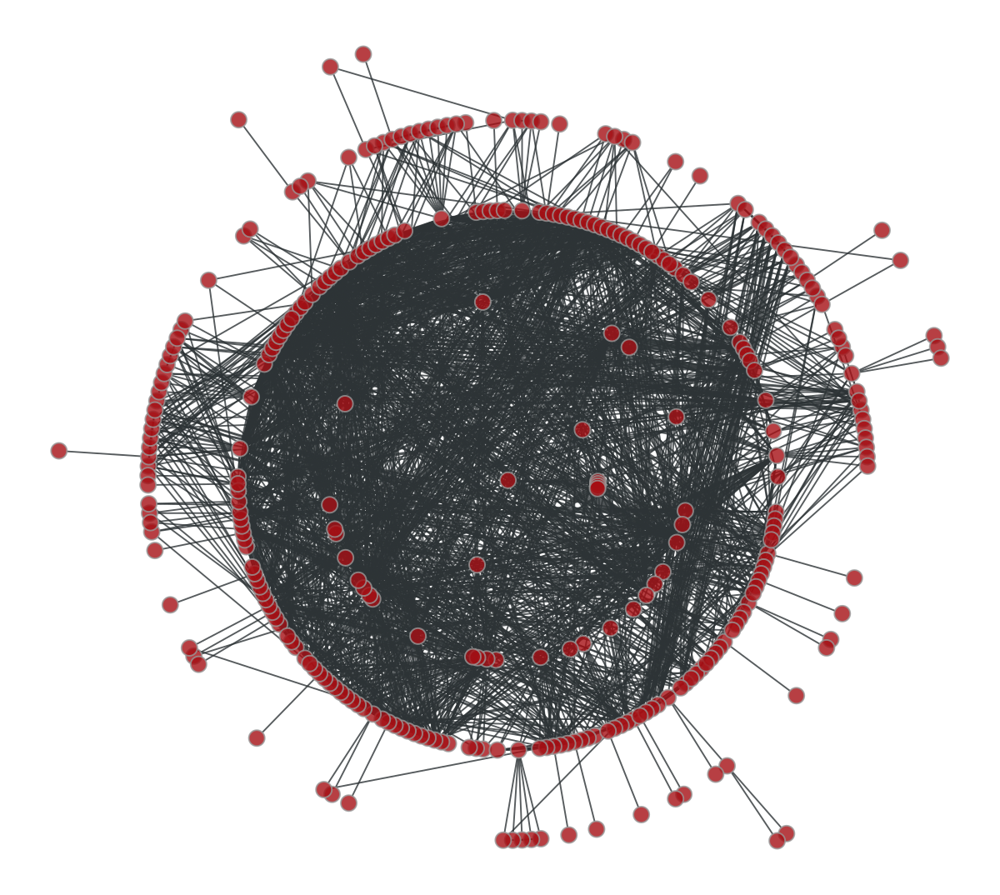

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf3dcab340>

In [75]:
gt.graph_draw(u_i, pos_tree_i)

In [76]:
# TODO: Adapt by placing node with most degrees at the center of the radial tree plot --------------------

# Calculate the radial tree layout for the graph 'u' starting from vertex 1.
# A radial tree layout is a layout algorithm that arranges the vertices in a tree-like structure
# with a central vertex (in this case, vertex 1) at the center and its connected vertices branching outward.
pos_tree_w = gt.radial_tree_layout(u_w, 1)

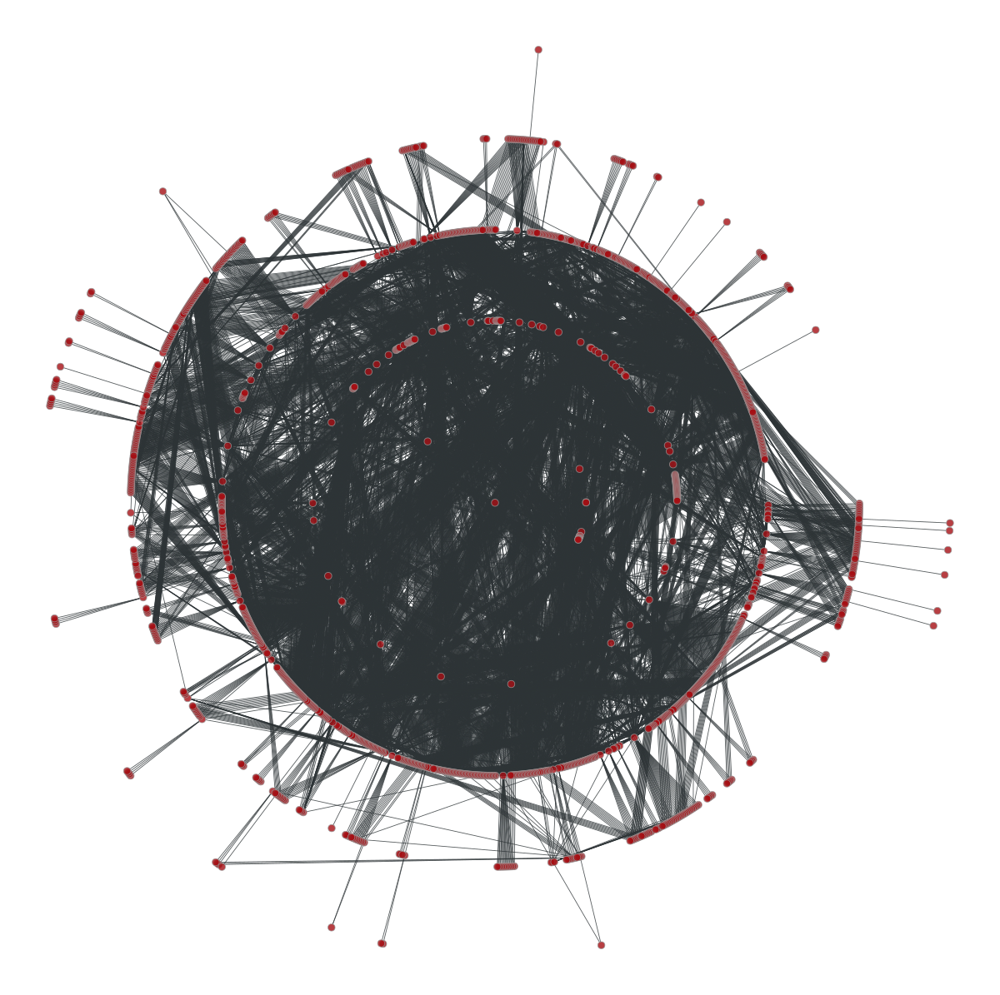

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf3e3c5e40>

In [77]:
gt.graph_draw(u_w, pos_tree_w)

## Hierarchical blocking model

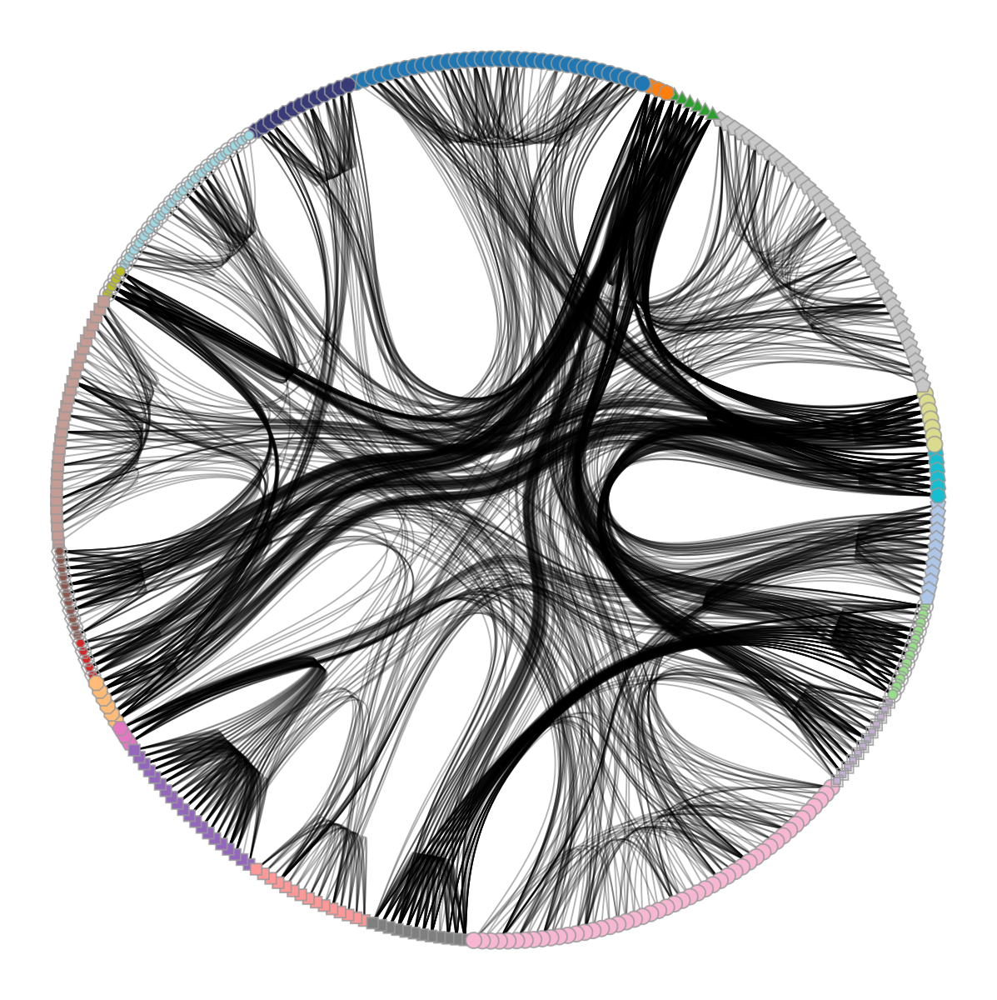

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf402f7a90>

In [78]:
# Perform hierarchical block modeling on the graph 'u' to identify nested communities.
state = gt.minimize_nested_blockmodel_dl(u_i)

# Get the hierarchy tree (rooted tree) from the state.
t = gt.get_hierarchy_tree(state)[0]

# Calculate the layout positions of the hierarchy tree 't' using a radial tree layout.
# The layout starts from the vertex at the bottom (last vertex), and it's weighted.
tpos = pos = gt.radial_tree_layout(t, t.vertex(t.num_vertices() - 1, use_index=False), weighted=True)

# Calculate the control points for edges in the hierarchy tree.
cts = gt.get_hierarchy_control_points(u_i, t, tpos)

# Assign the layout positions of 't' to the 'u' graph's vertices.
pos = u_i.own_property(tpos)

# Retrieve the block structure from the top level of the hierarchy.
b = state.levels[0].b

# Create a copy of the block structure for vertex shape assignments.
shape = b.copy()

# Adjust the vertex shapes by taking modulo 14 (cycling through shape options).
shape.a %= 14

# Use 'graph_draw' to visualize the 'u' graph with specified parameters.
gt.graph_draw(u_i, pos=pos, vertex_fill_color=b, vertex_shape=shape, edge_control_points=cts,
              edge_color=[0, 0, 0, 0.3], vertex_anchor=0)

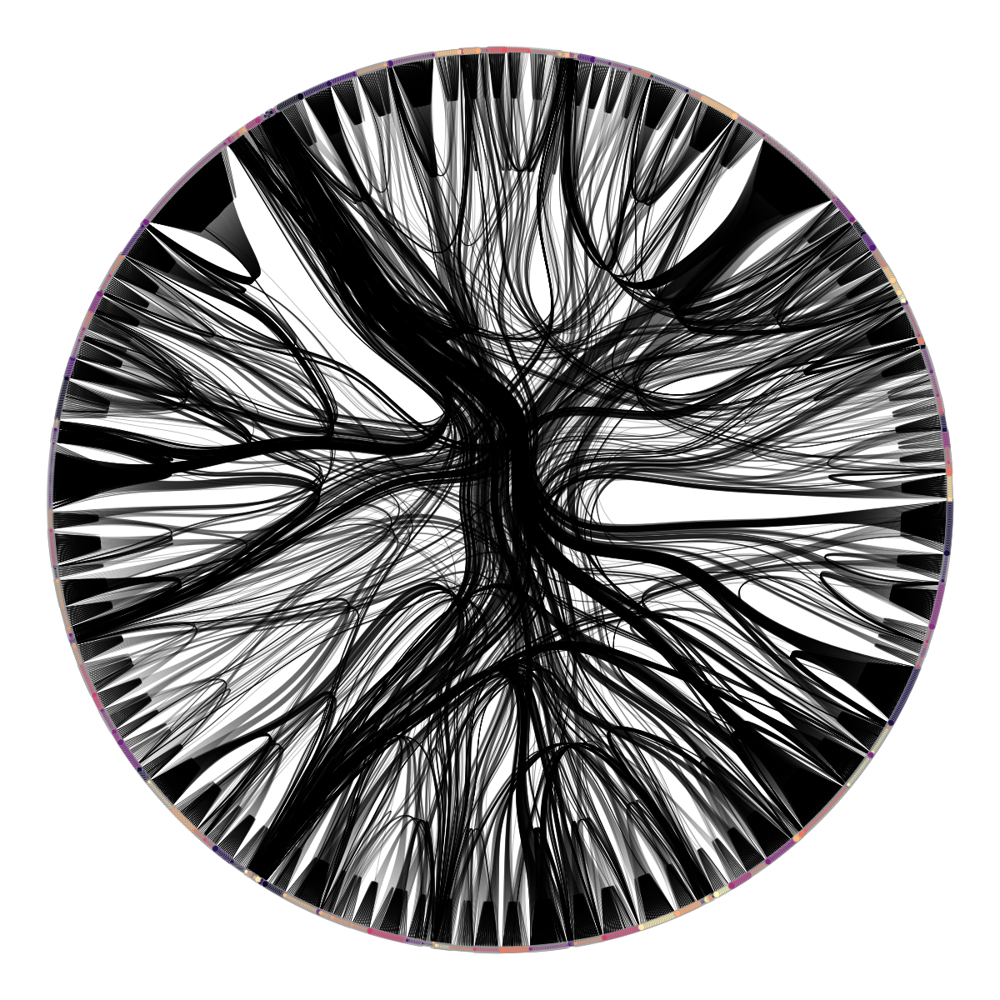

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf3dd4c1c0>

In [79]:
# Perform hierarchical block modeling on the graph 'u' to identify nested communities.
state = gt.minimize_nested_blockmodel_dl(u_w)

# Get the hierarchy tree (rooted tree) from the state.
t = gt.get_hierarchy_tree(state)[0]

# Calculate the layout positions of the hierarchy tree 't' using a radial tree layout.
# The layout starts from the vertex at the bottom (last vertex), and it's weighted.
tpos = pos = gt.radial_tree_layout(t, t.vertex(t.num_vertices() - 1, use_index=False), weighted=True)

# Calculate the control points for edges in the hierarchy tree.
cts = gt.get_hierarchy_control_points(u_w, t, tpos)

# Assign the layout positions of 't' to the 'u' graph's vertices.
pos = u_w.own_property(tpos)

# Retrieve the block structure from the top level of the hierarchy.
b = state.levels[0].b

# Create a copy of the block structure for vertex shape assignments.
shape = b.copy()

# Adjust the vertex shapes by taking modulo 14 (cycling through shape options).
shape.a %= 14

# Use 'graph_draw' to visualize the 'u' graph with specified parameters.
gt.graph_draw(u_w, pos=pos, vertex_fill_color=b, vertex_shape=shape, edge_control_points=cts,
              edge_color=[0, 0, 0, 0.3], vertex_anchor=0)

In [80]:
dist = gt.shortest_distance(u_i)

average_path_length = gt.vertex_average(u_i, dist)
print(np.mean(average_path_length))

1.4676638704272838704


# DRAFT
--------------------------------------------------

## Percolation

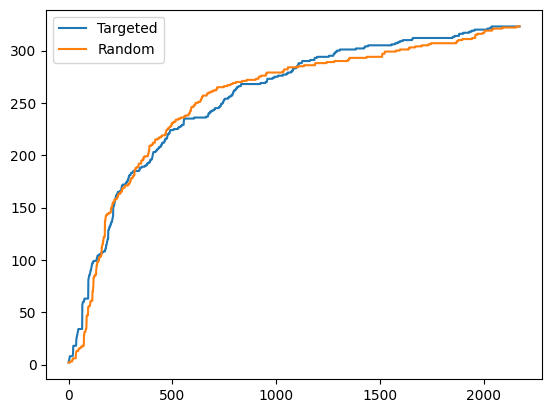

In [81]:
# TODO: Adapt to undirected network --------------------------------------------

# Generate a list of edges in the graph 'u', sorted by the product of their source and target vertices' in-degrees.
edges = sorted([(e.source(), e.target()) for e in u_i.edges()],
               key=lambda e: e[0].in_degree() * e[1].in_degree())

# Perform edge percolation on the graph 'u' using the sorted edges to target high in-degree vertices first.
sizes, comp = gt.edge_percolation(u_i, edges)

# Shuffle the order of edges randomly to perform edge percolation with a random order.
np.random.shuffle(edges)

# Perform edge percolation on the graph 'u' using the shuffled edges.
sizes2, comp = gt.edge_percolation(u_i, edges)

# Plot the sizes of the connected components for both targeted and random edge percolation.
plt.plot(sizes, label="Targeted")
plt.plot(sizes2, label="Random")

# Add a legend to distinguish the two percolation methods in the plot.
plt.legend()

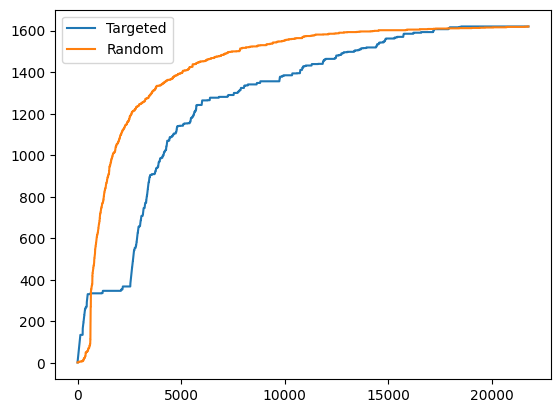

In [82]:
# TODO: Adapt to undirected network --------------------------------------------

# Generate a list of edges in the graph 'u', sorted by the product of their source and target vertices' in-degrees.
edges = sorted([(e.source(), e.target()) for e in u_w.edges()],
               key=lambda e: e[0].in_degree() * e[1].in_degree())

# Perform edge percolation on the graph 'u' using the sorted edges to target high in-degree vertices first.
sizes, comp = gt.edge_percolation(u_w, edges)

# Shuffle the order of edges randomly to perform edge percolation with a random order.
np.random.shuffle(edges)

# Perform edge percolation on the graph 'u' using the shuffled edges.
sizes2, comp = gt.edge_percolation(u_w, edges)

# Plot the sizes of the connected components for both targeted and random edge percolation.
plt.plot(sizes, label="Targeted")
plt.plot(sizes2, label="Random")

# Add a legend to distinguish the two percolation methods in the plot.
plt.legend()

## k-core decomposition

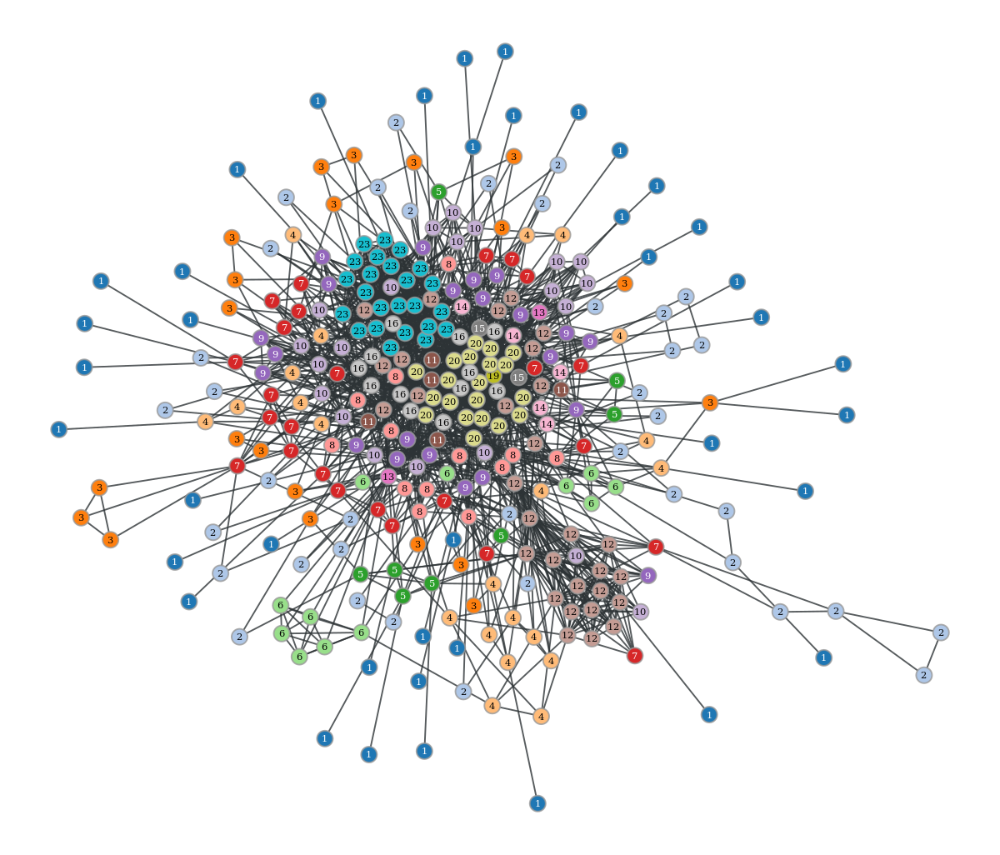

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf442182b0>

In [83]:
# The following code attempts to perform k-core decomposition on the graph 'u'.
# K-core decomposition is a graph analysis technique that identifies and assigns coreness values
# to nodes in the graph, indicating their level of connectedness within the graph.
kcore = gt.kcore_decomposition(u_i)

# The resulting coreness values are then used to color the vertices and display them with the coreness values as text.
gt.graph_draw(u_i, vertex_fill_color=kcore, vertex_text=kcore)

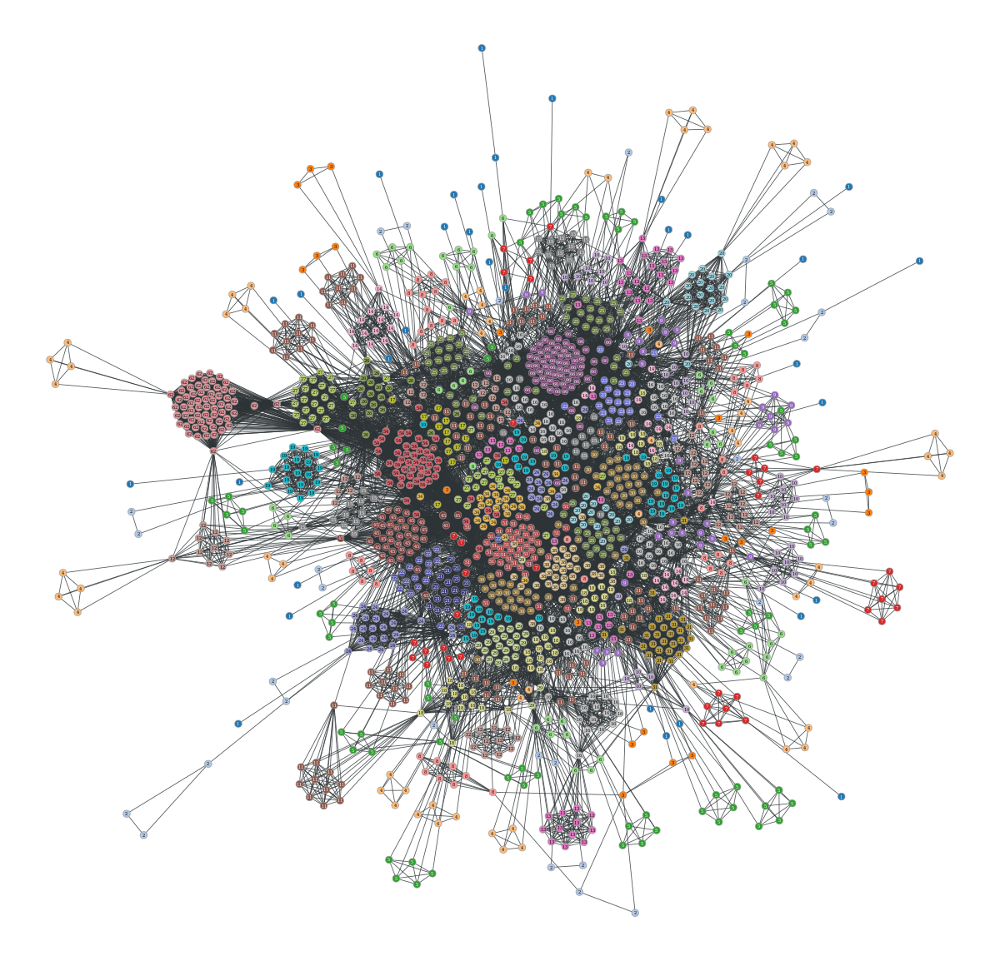

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf402aead0>

In [84]:
# The following code attempts to perform k-core decomposition on the graph 'u'.
# K-core decomposition is a graph analysis technique that identifies and assigns coreness values
# to nodes in the graph, indicating their level of connectedness within the graph.
kcore = gt.kcore_decomposition(u_w)

# The resulting coreness values are then used to color the vertices and display them with the coreness values as text.
gt.graph_draw(u_w, vertex_fill_color=kcore, vertex_text=kcore)

## Centrality measures

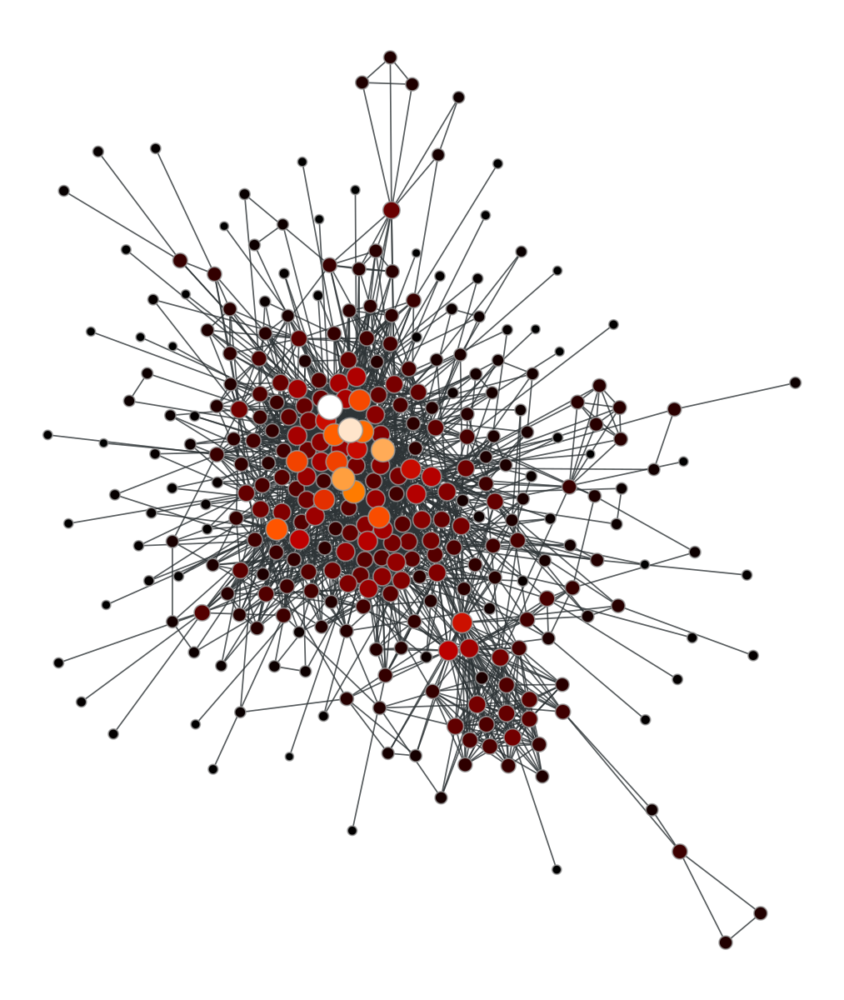

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf402ae860>

In [85]:
# Which pos_i do we use? -------------------------------------------------------

# Calculate the PageRank scores for the vertices in the graph 'u'.
pr = gt.pagerank(u_i)

# Visualize the graph 'u' with specific settings based on PageRank scores.
gt.graph_draw(u_i, pos=pos_i,

              vertex_fill_color=pr,  # Color the vertices based on their PageRank scores.

              vertex_size=gt.prop_to_size(pr, mi=5, ma=15),  # Adjust vertex size based on PageRank.

              vorder=pr,  # Set the vertex order based on PageRank scores.

              vcmap=matplotlib.cm.gist_heat)  # Use a colormap for vertex colors.

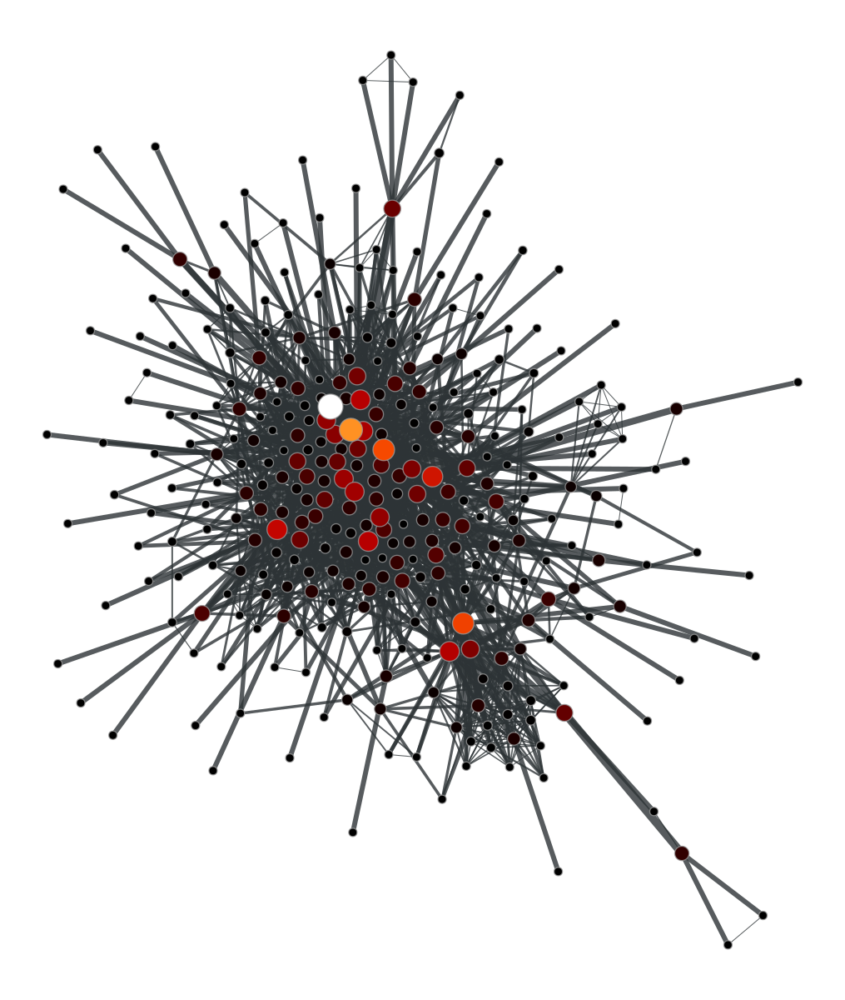

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf3e314ca0>

In [86]:
# Which pos_i do we use? -------------------------------------------------------

# Calculate the betweenness centrality for vertices (vp) and edges (ep) in the graph 'u'.
vp, ep = gt.betweenness(u_i)

# Visualize the graph 'u' with specific settings based on betweenness centrality.
gt.graph_draw(u_i, pos=pos_i,

              vertex_fill_color=vp,  # Color vertices based on their betweenness centrality.

              vertex_size=gt.prop_to_size(vp, mi=5, ma=15),  # Adjust vertex size based on betweenness centrality.

              edge_pen_width=gt.prop_to_size(ep, mi=0.5, ma=5),  # Adjust edge pen width based on edge betweenness.

              vcmap=matplotlib.cm.gist_heat,  # Use a colormap for vertex colors.

              vorder=vp)  # Set the vertex order based on betweenness centrality.

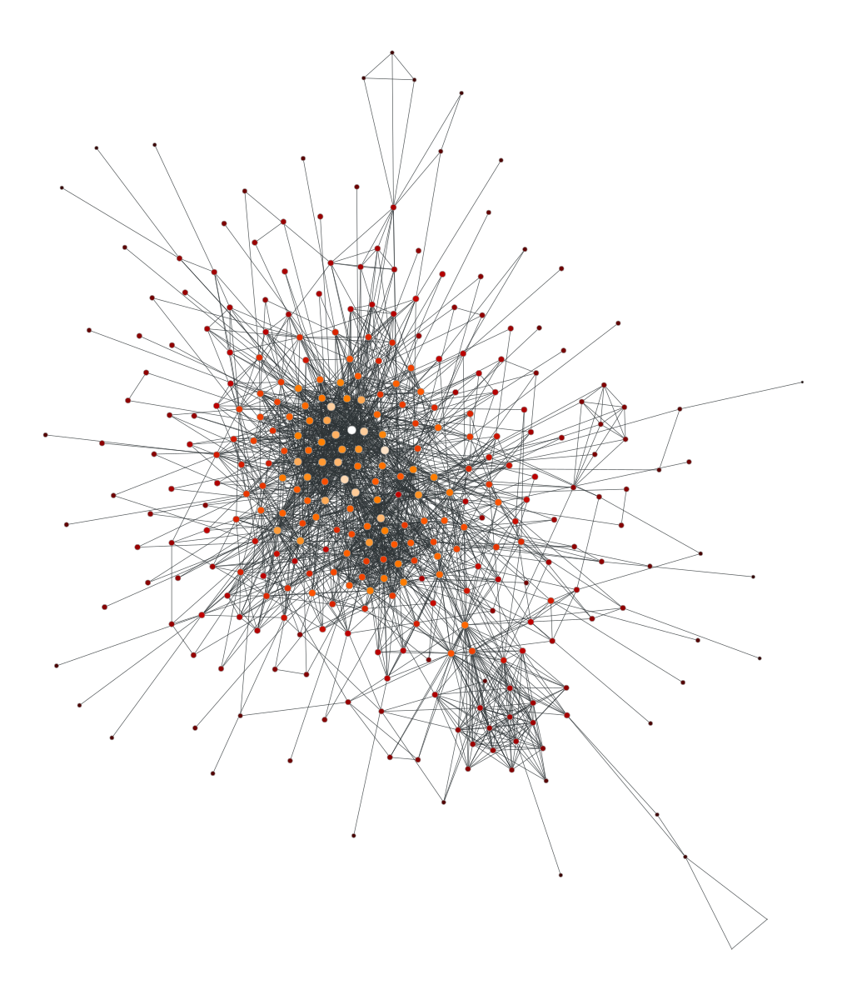

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf3e314760>

In [87]:
# Which pos_i do we use? -------------------------------------------------------

# Calculate the closeness centrality (c) for vertices in the graph 'u'.
c = gt.closeness(u_i)

# Visualize the graph 'u' with specific settings based on closeness centrality.
gt.graph_draw(u_i, pos=pos_i,

              vertex_fill_color=c,  # Color vertices based on their closeness centrality.

              vertex_size=gt.prop_to_size(c, mi=0.5, ma=5),  # Adjust vertex size based on closeness centrality.

              vcmap=matplotlib.cm.gist_heat,  # Use a colormap for vertex colors.

              vorder=c)  # Set the vertex order based on closeness centrality.

In [88]:
# # Which pos_i do we use? -------------------------------------------------------

# # Calculate the eigenvector centrality (x) for vertices in the graph 'u' using edge weights (u.ep["count"]).
# ee, x = gt.eigenvector(u_i, u_i.ep["count"])

# # Visualize the graph 'u' with specific settings based on eigenvector centrality.
# gt.graph_draw(u_i, pos=pos_i,

#               vertex_fill_color=x,  # Color vertices based on their eigenvector centrality.

#               vertex_size=gt.prop_to_size(x, mi=5, ma=15),  # Adjust vertex size based on eigenvector centrality.

#               vcmap=matplotlib.cm.gist_heat,  # Use a colormap for vertex colors.

#               vorder=x)  # Set the vertex order based on eigenvector centrality.

KeyError: ignored

In [173]:
# # Which pos_i do we use? -------------------------------------------------------

# # Visualize the graph 'u' with specific settings based on the provided layout positions (pos_fr).

# gt.graph_draw(u_i, pos=pos_fr_i,

#               vertex_fill_color=x,  # Color vertices based on a centrality measure (e.g., eigenvector centrality).

#               vertex_size=gt.prop_to_size(x, mi=5, ma=15),  # Adjust vertex size based on the centrality measure.

#               vcmap=matplotlib.cm.gist_heat,  # Use a colormap for vertex colors.

#               vorder=x)  # Set the vertex order based on the centrality measure.

TypeError: ignored

## Local clustering coefficients

In [174]:
# Calculate the local clustering coefficients for vertices in the graph 'u'.
clust_i = gt.local_clustering(u_i)

# Print the vertex average of the local clustering coefficients.
# This provides the average clustering coefficient across all vertices in the graph.
print(gt.vertex_average(u_i, clust_i))

print(clust_i.a)

(0.5750229444926509, 0.01972195453411829)
[1.         1.         0.25454545 1.         0.61666667 0.
 1.         1.         0.33333333 0.         0.4        0.
 1.         0.5        0.51111111 1.         0.66666667 0.52380952
 0.46666667 1.         0.67857143 0.52268908 0.         1.
 0.33333333 0.39869281 0.76363636 1.         0.1        0.75
 0.49264706 0.6        0.61111111 0.46783626 0.3        1.
 0.49206349 1.         0.48079659 0.42424242 0.38095238 0.3030303
 0.28884712 1.         0.42647059 1.         0.28205128 0.
 0.8        0.52046784 0.25358852 0.3355102  0.         0.4
 0.3        0.         0.         0.         0.37980085 1.
 0.26811594 1.         0.5        1.         0.38461538 1.
 1.         1.         0.2457483  1.         1.         0.
 0.         0.60130719 0.         0.3817734  0.30902778 0.6
 0.33454282 1.         0.20643939 0.33333333 1.         1.
 1.         0.38461538 0.         0.39393939 1.         0.37803922
 0.28307692 0.3974359  0.42857143 0.         0

In [175]:
# Calculate the local clustering coefficients for vertices in the graph 'u'.
clust_w = gt.local_clustering(u_w)

# Print the vertex average of the local clustering coefficients.
# This provides the average clustering coefficient across all vertices in the graph.
print(gt.vertex_average(u_w, clust_w))

print(clust_w.a)

(0.8911463919333029, 0.0058842927781668185)
[0.25182359 1.         0.61437908 ... 1.         1.         1.        ]


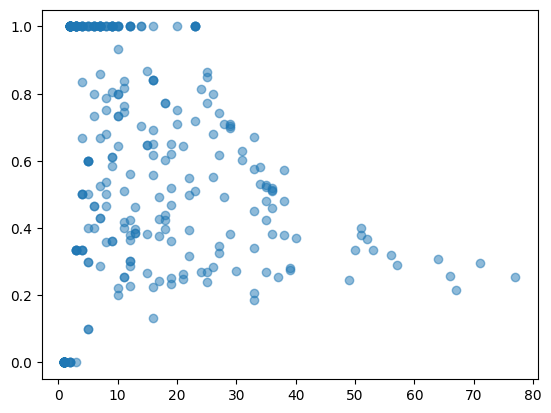

In [176]:
# Calculate the degrees of all vertices in the graph 'u' and store the results in the 'degs' variable.
degs_i = u_i.get_total_degrees(u_i.get_vertices())

# Create a scatter plot to visualize the relationship between degrees and local clustering coefficients.
# The 'out_degs' variable contains the out-degrees for each vertex, and 'clust.a' contains the local clustering coefficients.
# The 'alpha=0.5' parameter controls the transparency of the plotted points.
plt.scatter(degs_i, clust_i.a, alpha=0.5)

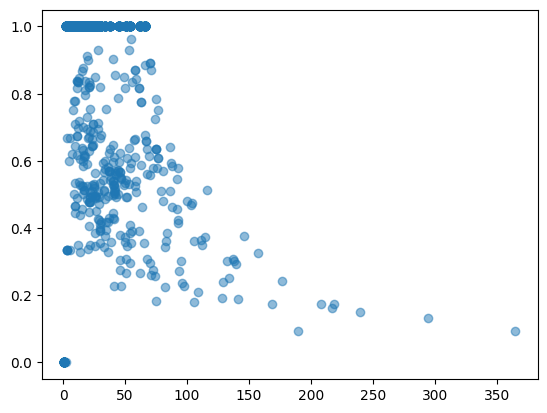

In [177]:
# Calculate the degrees of all vertices in the graph 'u' and store the results in the 'degs' variable.
degs_w = u_w.get_total_degrees(u_w.get_vertices())

# Create a scatter plot to visualize the relationship between out-degrees and local clustering coefficients.
# The 'out_degs' variable contains the out-degrees for each vertex, and 'clust.a' contains the local clustering coefficients.
# The 'alpha=0.5' parameter controls the transparency of the plotted points.
plt.scatter(degs_w, clust_w.a, alpha=0.5)

## Blockmodel

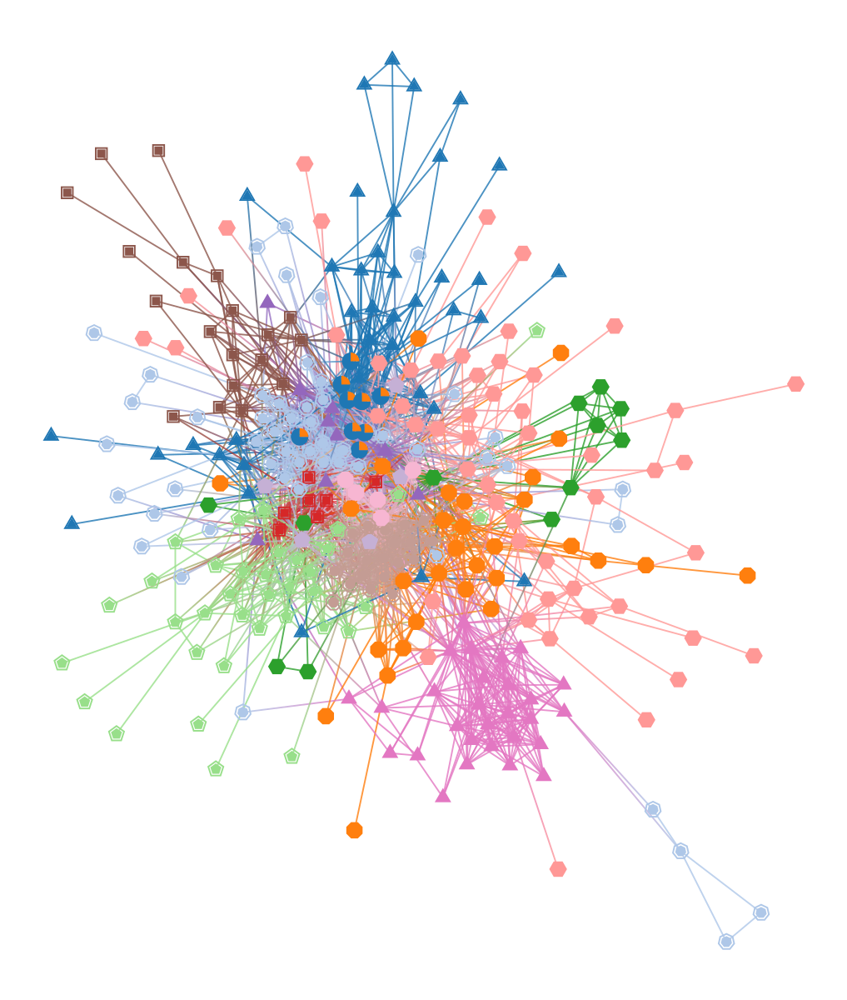

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf3cba30a0>

In [178]:
# Which pos_i do we use? -------------------------------------------------------

# Perform a blockmodel decomposition on the graph 'u' to identify community structure.
state_i = gt.minimize_blockmodel_dl(u_i)

# Visualize the blockmodel using layout positions from the 'u' graph and vertex shapes based on the block assignments.
state_i.draw(pos=pos_i, vertex_shape=state_i.get_blocks())

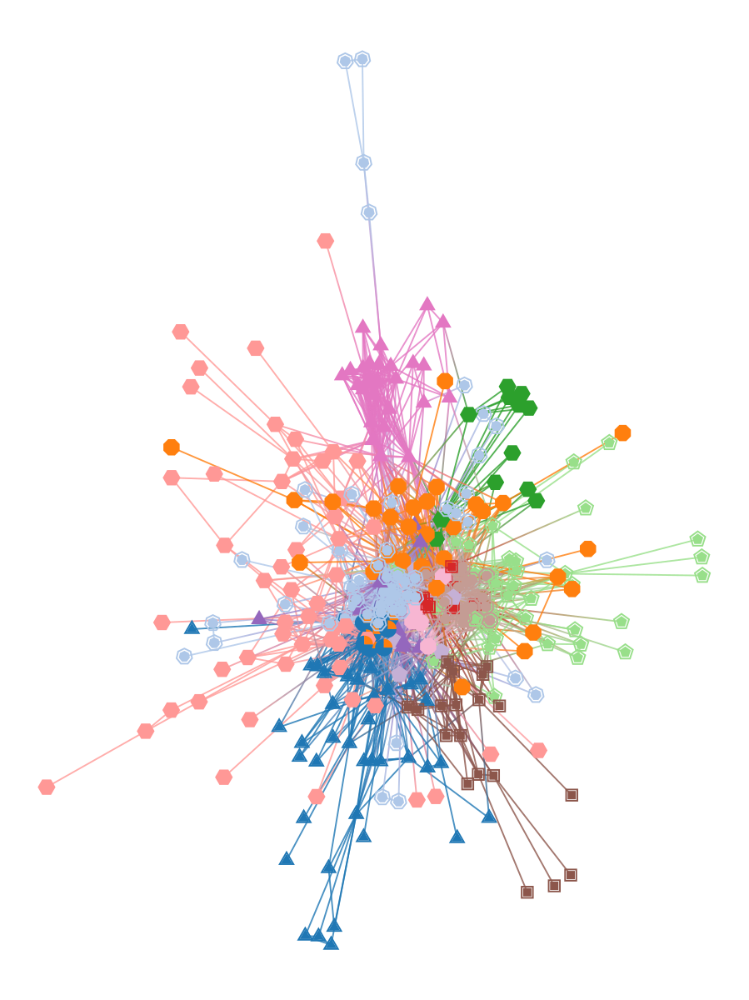

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf42b8db70>

In [179]:
# Visualize the blockmodel using custom layout positions ('pos_fr') and vertex shapes based on the block assignments.
state_i.draw(pos=pos_fr_i, vertex_shape=state_i.get_blocks())

In [180]:
# # Which pos_i do we use? -------------------------------------------------------

# # Visualize the blockmodel using custom layout positions ('pos_fr'), vertex shapes based on block assignments,
# # and vertex sizes determined by a property 'x'.
# state_i.draw(pos=pos_fr_i, vertex_shape=state_i.get_blocks(), vertex_size=gt.prop_to_size(x, mi=5, ma=25))

TypeError: ignored

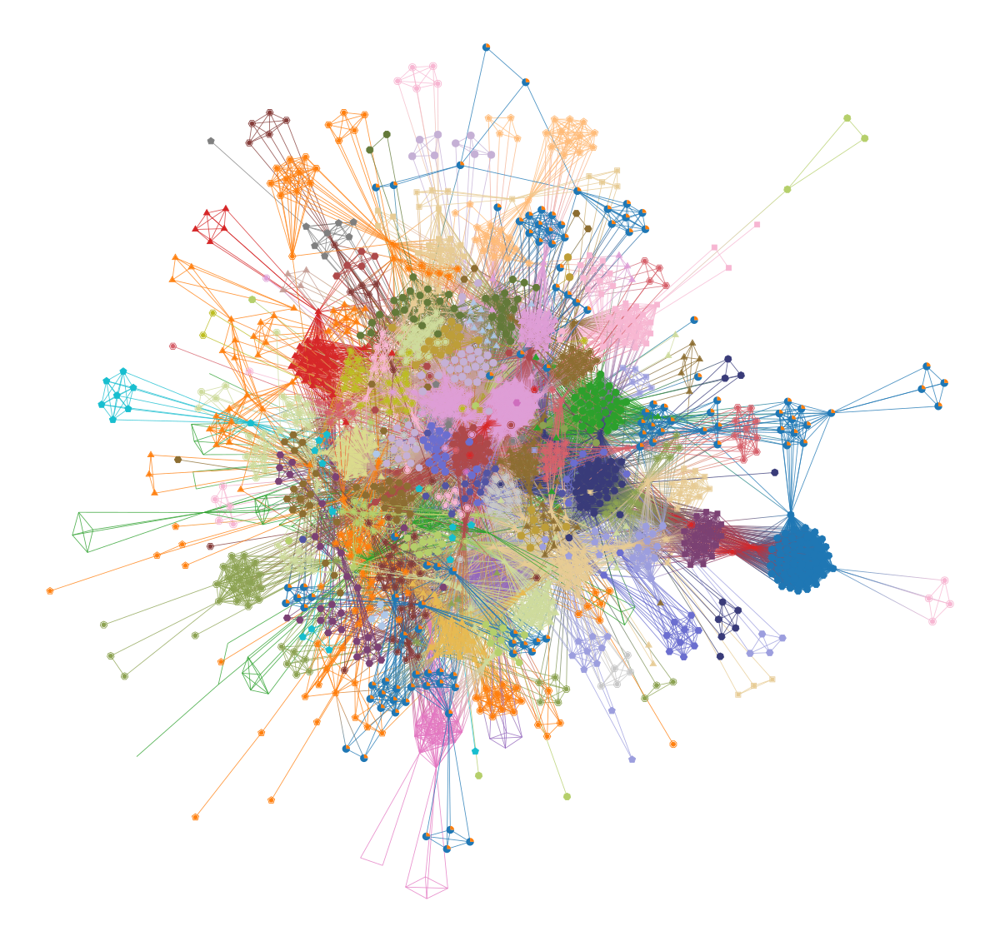

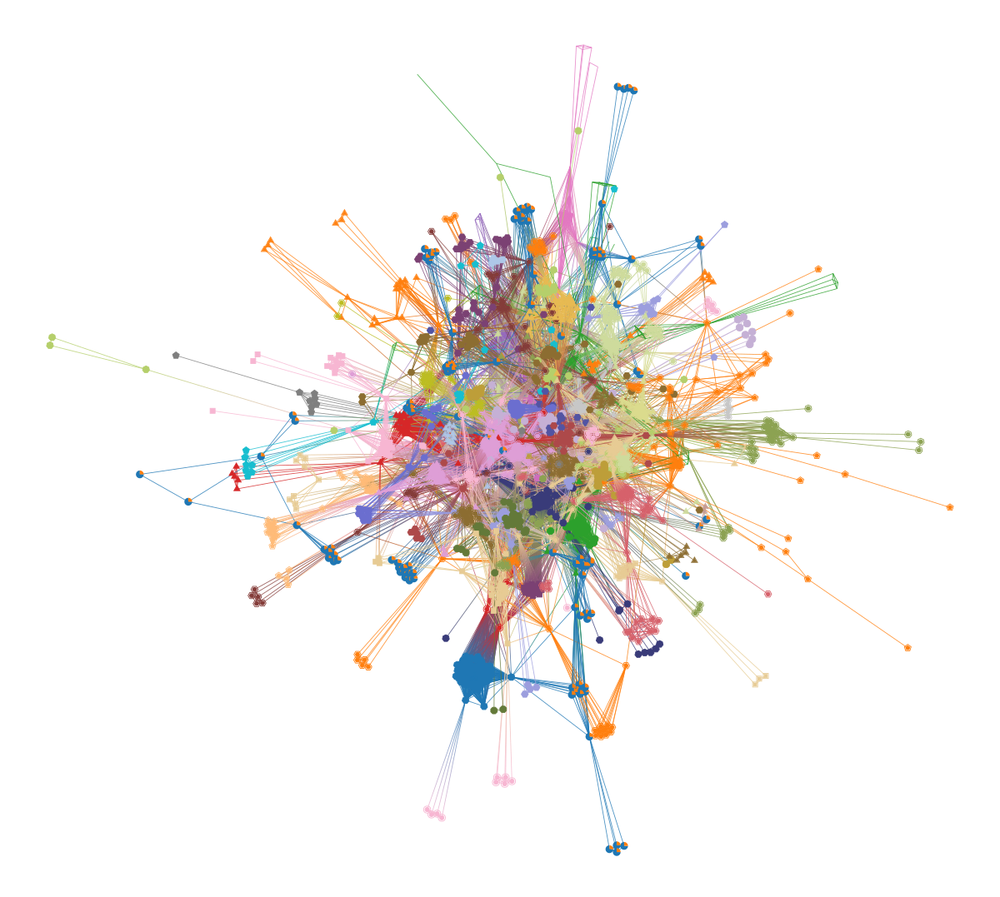

<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf3b4683d0>

In [181]:
# Which pos_i do we use? -------------------------------------------------------

# Perform a blockmodel decomposition on the graph 'u' to identify community structure.
state_w = gt.minimize_blockmodel_dl(u_w)

# Visualize the blockmodel using layout positions from the 'u' graph and vertex shapes based on the block assignments.
state_w.draw(pos=pos_w, vertex_shape=state_w.get_blocks())

# Visualize the blockmodel using custom layout positions ('pos_fr') and vertex shapes based on the block assignments.
state_w.draw(pos=pos_fr_w, vertex_shape=state_w.get_blocks())

In [ ]:
# # Visualize the blockmodel using custom layout positions ('pos_fr'), vertex shapes based on block assignments,
# # and vertex sizes determined by a property 'x'.
# state_w.draw(pos=pos_fr_w, vertex_shape=state_w.get_blocks(), vertex_size=gt.prop_to_size(x, mi=5, ma=25))

## Blockmodel decomposition

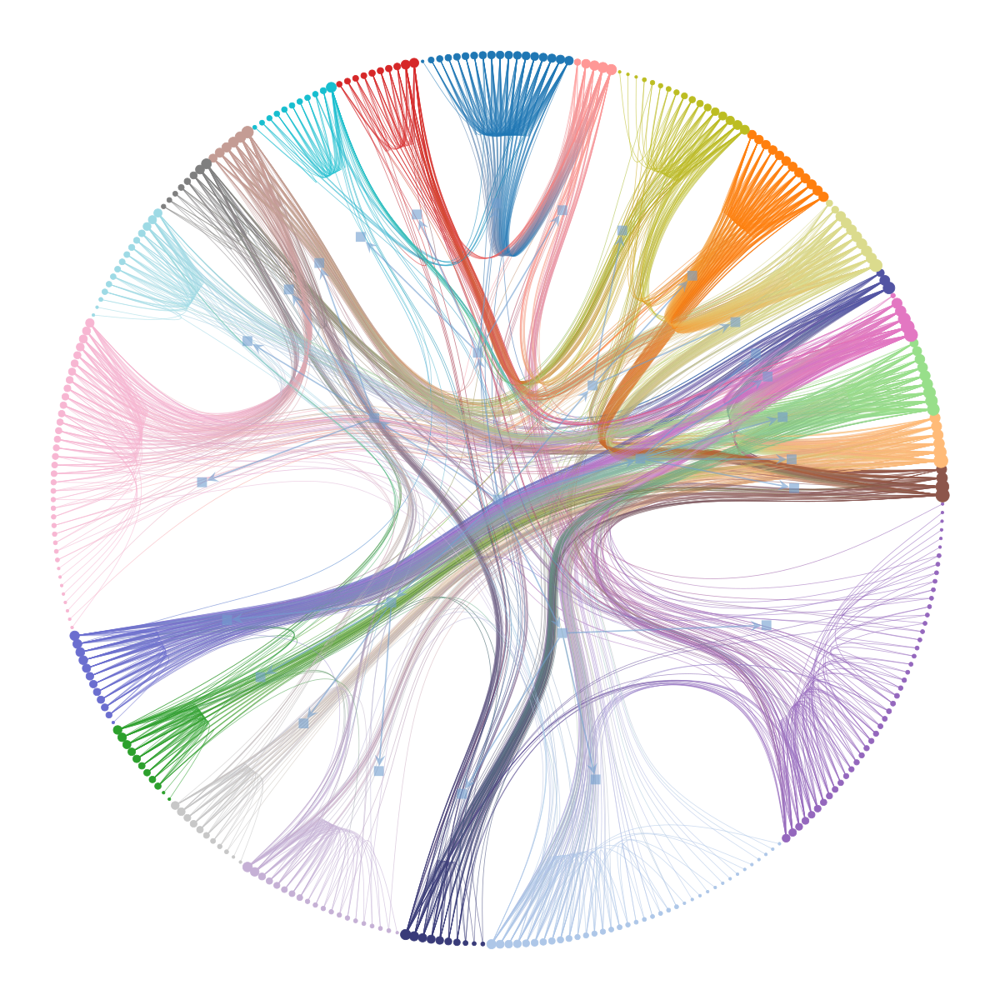

(<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3dcda590, at 0x78cf396175e0>,
 <GraphView object, directed, with 353 vertices and 352 edges, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x78cf39616b00, at 0x78cf395209d0>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x78cf39616b00, at 0x78cf39521bd0>, False), at 0x78cf39616b00>,
 <VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf39616b00, at 0x78cf395221a0>)

In [182]:
# Perform a nested blockmodel decomposition on the graph 'u' to identify hierarchical community structure.
state2_i = gt.minimize_nested_blockmodel_dl(u_i)

# Visualize the nested blockmodel structure.
state2_i.draw()

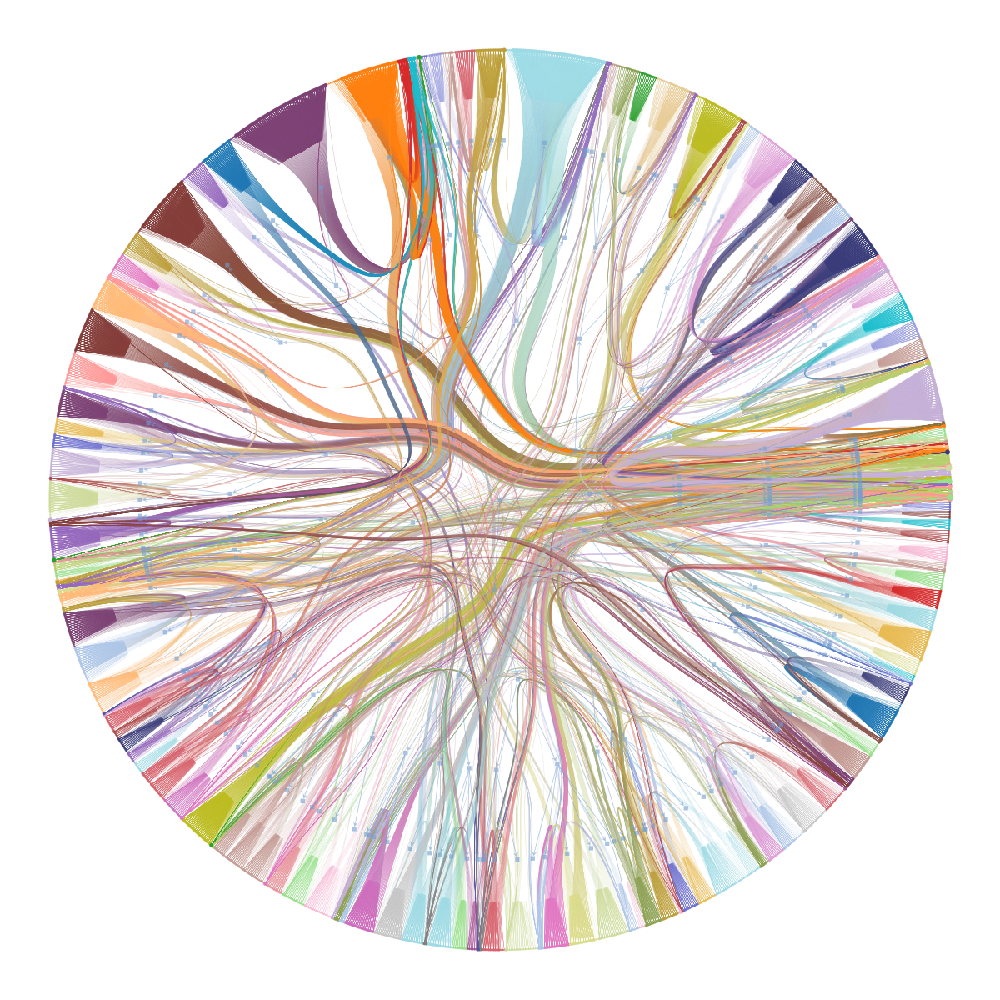

(<VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3e314310, at 0x78cf3bbb5750>,
 <GraphView object, directed, with 1881 vertices and 1880 edges, edges filtered by (<EdgePropertyMap object with value type 'bool', for Graph 0x78cf3bbb6620, at 0x78cf3946fd00>, False), vertices filtered by (<VertexPropertyMap object with value type 'bool', for Graph 0x78cf3bbb6620, at 0x78cf3946dcc0>, False), at 0x78cf3bbb6620>,
 <VertexPropertyMap object with value type 'vector<double>', for Graph 0x78cf3bbb6620, at 0x78cf3946e1a0>)

In [183]:
# Perform a nested blockmodel decomposition on the graph 'u' to identify hierarchical community structure.
state2_w = gt.minimize_nested_blockmodel_dl(u_w)

# Visualize the nested blockmodel structure.
state2_w.draw()

In [184]:
# Print the block assignments for each vertex in the blockmodel created using the 'state' object.
print(state_i.get_blocks().a)

[201  84 161  54 148  24 148  84  44 122 201  44  84 148 253  44 122 148
 289  24 201 310  44  24  54 122 289  24 201 122 122  54  24  24  54  24
 137 253  78 148  84 148  78  44  24 253  78 148 148  44  78 137 148 148
 148 148 148  44 161 148 195  44 122  44 122  84 122  24 137 122  44 148
 148 289 148 289 310 148 161 122 195 148  24  84 253 122  44  78 148  78
  54 122 148 148 122 122 148  54 148  84  54 201  44  44 289 201 201  44
 289 122 289 148 122  44 122 122  24  44 289 161  54 122  84  44 253  84
  24 161  54  44  54 289 289 148 195  54 122 122  44 253  54  24 289  54
  78  44  24  44 122 253 201 253 148  44  44 289  44  24 122 289  44  54
 161  54  24 148 289 148 122  24 161  54 148 148 289 122  44  84  54 201
  44  44 137 310 148  54 253  84 122 310 148 253  24  44 195 289 201 289
  44  24 201  24  44 148 122  78 253  24  44 122 201 148  54  44 148 122
 201 201 122 148  44 137 253  54 137 253 122  44 201  44  44  24  44  54
  54 148  54  44  24 289 148  54  44  24 289  78 13

In [185]:
# Print the block assignments for each vertex in the blockmodel created using the 'state' object.
print(state_w.get_blocks().a)

[ 963 1289 1289 ... 1613 1613 1613]


## Save subsets of networks

In [ ]:
# u.save("eu_procurements_2.graphml")